In [130]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [131]:
#!pip install pandas
#!pip install tqdm

#!pip install scipy
#!pip install matchms
#!pip install scikit-learn
#!pip install spec2vec
#!pip install seaborn

In [132]:
import os
os.chdir('/Users/sebas/projects/metabolomics')
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"

In [133]:
from src.transformers.sklearn_model import SklearnModel

In [134]:
import gensim
from src.load_data import LoadData
from src.config import Config
from matchms import calculate_scores
from matchms.importing import load_from_mgf,load_from_msp
import matchms.filtering as msfilters
from spec2vec import SpectrumDocument
from spec2vec.model_building import train_new_word2vec_model
from tqdm import tqdm
from src.loader_saver import LoaderSaver
import itertools
import numpy as np
from matchms.importing import load_from_msp
from matchms.similarity import ModifiedCosine
from scipy.stats import spearmanr
import dill
from src.plotting import Plotting
from src.load_data import LoadData
from sklearn.model_selection import train_test_split
from src.train_utils import TrainUtils
from src.preprocessor import Preprocessor
from matchms.filtering import add_fingerprint
import pickle
import sys
from src.config import Config
from src.parser import Parser
from datetime import datetime
from src.loader_saver import LoaderSaver
from src.spec2vec_comparison import Spec2VecComparison
from src.ms2deepscore_comparison import MS2DeepScoreComparison
from src.molecular_pairs_set import MolecularPairsSet
from scipy.stats import spearmanr

In [135]:
from src.transformers.embedder import Embedder

In [136]:
ls /Users/sebas/projects/data

ALL_GNPS_NO_PROPOGATED_wb.mgf
GNPS-NIH-NATURALPRODUCTSLIBRARY.mgf
all_spectrums_gnps.pkl
all_spectrums_gnps_nist_20240130_gnps_nist_janssen.pkl
all_spectrums_janssen.pkl
all_spectrums_nist.pkl
best_model.ckpt
best_model_128n_10_layers_20240209.ckpt
best_model_128n_5_layers_20240219_elementwise.ckpt
drug_plus.mgf
hr_msms_nist_all.MSP*
hr_msms_nist_sample.MSP
merged_gnps_nist_20240118_gnps_nist_janssen.pkl
merged_gnps_nist_20240207_gnps_nist_janssen_15_millions.pkl
ms2deepscore_positive_10k_1000_1000_1000_500.hdf5
spec2vec_AllPositive_ratio05_filtered_201101_iter_15.model
spec2vec_AllPositive_ratio05_filtered_201101_iter_15.model.trainables.syn1neg.npy
spec2vec_AllPositive_ratio05_filtered_201101_iter_15.model.wv.vectors.npy
to_export_gnps_nist.pkl
uniformed_molecule_pairs_test.pkl


## Parameters

#### data_folder= '/Users/sebas/projects/data/'
dataset_path = data_folder + 'uniformed_molecule_pairs_test.pkl'
gnps_path =  data_folder + 'ALL_GNPS_NO_PROPOGATED_wb.mgf'
janssen_path = data_folder + 'drug_plus.mgf'
nist_path = data_folder + 'hr_msms_nist_all.MSP'
output_pairs_file= data_folder + 'molecular_pairs.pkl'
output_nist_file= data_folder + 'all_spectrums_nist.pkl'
output_gnps_file= data_folder + 'all_spectrums_gnps.pkl'
output_janssen_file= data_folder + 'all_spectrums_janssen.pkl'
model_spec2vec_file = data_folder + 'spec2vec_AllPositive_ratio05_filtered_201101_iter_15.model'
model_ms2d_file= data_folder + 'ms2deepscore_positive_10k_1000_1000_1000_500.hdf5'
#uniformed_molecule_pairs_test_path= data_folder +'uniformed_molecule_pairs_test.pkl'
uniformed_molecule_pairs_test_path= data_folder +'merged_gnps_nist_20240207_gnps_nist_janssen_15_millions.pkl'
transformer_path = data_folder + 'best_model_128n_5_layers_20240219_elementwise.ckpt'

In [137]:
THRESHOLD_ANALOG=0.7

In [138]:
load_molecule_pairs_file= True
only_use_gnps=True

In [139]:
## Load spectrum using spectrumutils

In [140]:
config=Config()

## Load data from matchms

In [141]:
all_spectrums_gnps_MATCHMS = [(s) for s in load_from_mgf(gnps_path)]

In [142]:
all_spectrums_janssen_MATCHMS = [(s) for s in load_from_mgf(janssen_path)]

2024-02-20 10:24:19,097:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,099:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,100:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,100:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,101:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,102:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,103:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,103:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,104:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,105:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,105:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,106:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,107:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,107:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,108:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,109:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,110:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,111:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,111:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,113:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,114:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,114:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,115:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,117:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,118:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,119:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,119:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,120:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,122:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,122:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,123:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,124:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,125:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,126:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,126:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,127:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,128:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,129:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,130:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,131:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,132:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,134:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,135:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,135:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,136:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,137:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,139:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,139:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,140:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,141:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,141:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,142:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,143:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,144:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,145:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,145:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,146:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,146:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,147:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,148:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,149:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,151:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,152:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,154:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,155:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,156:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,158:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,159:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,161:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,163:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,165:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,166:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,166:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,168:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,169:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,170:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,171:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,172:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,172:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,174:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,177:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,177:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,179:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,180:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,181:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,181:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,182:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,183:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,184:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,185:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,186:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,188:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,189:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,189:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,190:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,191:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,192:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,193:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,194:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,194:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,195:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,196:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,197:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,198:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,199:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,200:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,201:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,204:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,204:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,205:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,206:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,206:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,208:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,209:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,209:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,210:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,211:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,211:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,212:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,213:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,213:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,214:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,215:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,216:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,216:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,217:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,218:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,219:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,219:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,220:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,220:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,222:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,223:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,225:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,225:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,226:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,226:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,227:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,228:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,228:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,231:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,231:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,233:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,234:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,236:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,237:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,238:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,241:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,242:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,244:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,245:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,246:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,247:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,247:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,248:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,249:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,250:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,251:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,252:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,255:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,259:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,260:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,260:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,261:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,263:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,265:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,266:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,267:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,269:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,271:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,272:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,274:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,275:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,276:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,277:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,277:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,280:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,281:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,282:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,282:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,283:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,284:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,285:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,286:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,286:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,288:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,288:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,289:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,290:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,292:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,293:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,295:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,296:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,298:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,299:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,300:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,301:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,302:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,304:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,305:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,305:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,306:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,309:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,310:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,311:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,312:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,314:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,315:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,317:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,318:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,319:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,320:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,321:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,325:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,326:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,327:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,330:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,330:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,331:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,332:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,333:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,334:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,336:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,337:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,338:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,340:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,341:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,342:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,343:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,344:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,349:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,351:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,353:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,357:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,357:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,358:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,360:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,361:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,362:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,364:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,365:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,366:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,370:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,371:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,371:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,372:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,373:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,373:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,374:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,374:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,375:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,375:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,376:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,376:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,377:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,377:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,378:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,378:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,379:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,380:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,389:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,390:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,390:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,391:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,391:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,392:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,393:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,393:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,394:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,394:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,395:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,395:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,396:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,396:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,397:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,397:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,398:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,398:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,399:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,400:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,400:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,401:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,401:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,402:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,402:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,403:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,403:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,404:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,404:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,405:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,405:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,406:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,406:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,407:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,408:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,408:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,409:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,409:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,410:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,410:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,411:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,411:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,412:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,412:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,413:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,413:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,414:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,414:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,415:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,415:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,416:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,416:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,417:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,418:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,418:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,419:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,419:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,420:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,420:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,421:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,421:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,422:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,422:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,423:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,423:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,424:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,424:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,425:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,426:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,426:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,427:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,427:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,428:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,428:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,429:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,429:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,430:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,430:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,431:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,432:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,432:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,433:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,433:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,434:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,434:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,435:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,435:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,436:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,436:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,437:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,437:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,438:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,438:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,439:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,439:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,440:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,440:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,441:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,441:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,442:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,442:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,443:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,444:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,444:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,445:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,445:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,446:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,446:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,447:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,447:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,448:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,449:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,449:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,450:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,450:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,451:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,451:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,451:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,452:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,452:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,453:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,453:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,454:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,454:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,455:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,456:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,456:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,457:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,457:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,458:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,458:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,459:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,459:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,460:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,460:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,461:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,461:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,462:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,462:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,463:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,463:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,464:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,465:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,465:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,465:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,466:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,467:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,467:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,468:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,468:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,469:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,469:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,470:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,470:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,471:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,471:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,471:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,472:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,472:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,473:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,473:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,474:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,474:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,475:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,475:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,476:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,514:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,515:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,515:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,515:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,516:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,516:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,517:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,517:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,518:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,518:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,519:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,520:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,520:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,520:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,521:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,522:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,522:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,522:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,523:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,523:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,524:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,524:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,525:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,525:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,526:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,527:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,527:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,528:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,528:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,529:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,529:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,530:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,530:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,531:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,531:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,532:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,532:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,533:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,533:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,534:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,534:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,535:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,535:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,536:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,536:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,537:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,538:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,538:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,539:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,539:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,540:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,540:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,541:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,541:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,542:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,542:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,543:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,543:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,544:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,544:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,545:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,546:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,546:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,547:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,547:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,548:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,548:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,549:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,549:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,550:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,550:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,551:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,551:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,552:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,552:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,553:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,554:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,554:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,555:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,555:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,556:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,556:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,557:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,557:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,558:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,558:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,559:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,559:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,560:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,560:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,561:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,561:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,562:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,563:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,563:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,564:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,564:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,565:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,565:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,566:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,566:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,567:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,567:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,568:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,568:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,569:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,569:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,570:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,571:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,571:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,572:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,572:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,573:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,573:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,574:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,574:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,575:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,575:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,576:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,576:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,577:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,577:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,578:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,578:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,579:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,579:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,580:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,581:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,581:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,582:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,582:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,583:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,583:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,584:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,584:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,585:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,586:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,586:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,587:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,587:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,588:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,588:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,589:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,589:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,590:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,590:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,591:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,591:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,592:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,593:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,593:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,594:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,594:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,595:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,595:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,596:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,596:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,597:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,598:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,598:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,599:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,599:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,600:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,600:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,601:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,601:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,602:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,640:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,640:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,641:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,641:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,642:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,642:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,643:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,644:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,644:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,645:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,645:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,646:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,646:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,647:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,647:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,648:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,648:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,649:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,649:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,650:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,650:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,651:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,651:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,652:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,652:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,653:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,653:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,654:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,654:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,655:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,655:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,656:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,656:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,657:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,657:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,658:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,658:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,659:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,659:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,660:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,660:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,661:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,661:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,662:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,662:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,663:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,663:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,664:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,665:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,665:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,666:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,666:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,667:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,667:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,668:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,668:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,669:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,669:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,670:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,670:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,671:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,672:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,672:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,673:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,673:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,674:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,674:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,675:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,675:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,676:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,677:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,677:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,678:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,678:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,679:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,679:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,680:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,680:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,681:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,681:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,682:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,683:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,683:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,684:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,684:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,685:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,685:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,686:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,686:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,687:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,687:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,688:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,688:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,689:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,689:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,690:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,691:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,691:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,692:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,692:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,693:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,693:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,694:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,694:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,695:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,695:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,696:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,696:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,697:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,697:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,698:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,698:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,699:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,700:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,700:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,701:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,701:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,702:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,702:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,703:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,703:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,704:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,704:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,705:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,705:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,706:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,706:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,707:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,707:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,708:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,708:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,709:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,709:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,710:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,710:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,711:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,711:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,712:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,712:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,713:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,713:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,714:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,714:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,715:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,716:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,716:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,717:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,717:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,718:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,718:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,719:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,719:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,720:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,720:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,721:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,721:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,722:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,722:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,723:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,724:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,724:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,725:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,725:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,726:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,726:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,727:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,727:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,765:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,766:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,766:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,767:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,767:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,768:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,768:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,769:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,769:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,770:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,770:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,771:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,771:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,772:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,772:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,773:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,773:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,773:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,774:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,775:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,775:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,776:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,776:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,776:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,777:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,777:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,778:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,779:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,779:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,779:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,780:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,780:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,781:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,782:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,782:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,783:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,783:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,784:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,784:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,785:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,785:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,786:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,786:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,787:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,787:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,788:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,788:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,789:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,789:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,790:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,790:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,791:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,791:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,792:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,792:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,793:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,793:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,794:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,794:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,795:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,795:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,796:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,796:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,797:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,798:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,798:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,799:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,799:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,800:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,800:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,800:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,801:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,801:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,802:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,802:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,803:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,803:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,804:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,804:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,805:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,805:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,806:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,806:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,807:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,807:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,808:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,808:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,809:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,809:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,810:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,810:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,811:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,811:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,812:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,813:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,813:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,813:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,814:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,814:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,815:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,815:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,816:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,816:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,817:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,817:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,818:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,819:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,819:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,819:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,820:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,820:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,821:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,821:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,822:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,822:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,823:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,823:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,824:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,824:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,825:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,825:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,826:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,826:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,827:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,827:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,828:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,829:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,829:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,829:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,830:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,830:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,831:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,831:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,832:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,832:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,833:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,834:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,834:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,835:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,835:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,836:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,836:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,837:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,837:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,838:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,838:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,839:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,839:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,840:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,840:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,841:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,842:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,842:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,843:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,843:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,844:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,844:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,845:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,845:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,846:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,846:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,847:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,847:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,848:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,848:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,849:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,887:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,887:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,888:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,888:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,889:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,890:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,890:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,891:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,891:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,892:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,893:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,893:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,894:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,894:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,895:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,895:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,896:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,897:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,897:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,898:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,898:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,899:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,899:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,900:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,901:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,901:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,902:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,902:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,903:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,903:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,904:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,904:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,905:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,905:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,906:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,906:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,907:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,908:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,908:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,909:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,909:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,910:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,910:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,911:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,911:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,912:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,913:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,913:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,914:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,914:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,915:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,915:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,916:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,917:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,917:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,918:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,918:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,919:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,919:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,920:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,920:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,921:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,921:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,922:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,922:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,923:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,924:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,924:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,925:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,925:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,926:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,926:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,927:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,928:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,928:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,929:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,929:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,930:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,930:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,931:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,931:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,932:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,933:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,933:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,934:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,934:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,935:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,935:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,936:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,936:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,937:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,937:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,938:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,938:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,939:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,940:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,940:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,941:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,941:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,942:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,942:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,943:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,943:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,944:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,944:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,945:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,946:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,946:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,947:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,947:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,948:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,948:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,949:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,949:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,950:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,950:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,951:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,951:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,952:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,952:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,953:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,954:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,954:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,955:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,955:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,956:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,956:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,957:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,957:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,958:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,959:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,959:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,960:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,960:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,961:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,961:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,962:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,963:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,963:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,964:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,964:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,965:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,966:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,966:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,967:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,967:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,968:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,968:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,969:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,970:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,970:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,971:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,971:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,972:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,972:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,973:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,974:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,974:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,975:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,975:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,976:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,977:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,977:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,978:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,978:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,979:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,979:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:19,999:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,000:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,001:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,001:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,002:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,002:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,003:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,004:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,004:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,005:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,005:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,006:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,007:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,007:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,008:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,009:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,010:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,010:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,011:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,011:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,012:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,013:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,014:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,014:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,016:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,017:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,017:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,018:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,019:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,019:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,020:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,021:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,022:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,023:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,023:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,024:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,025:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,026:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,026:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,027:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,028:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,029:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,029:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,030:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,030:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,031:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,032:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,033:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,033:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,034:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,035:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,035:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,036:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,037:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,039:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,039:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,040:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,041:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,042:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,042:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,043:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,044:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,044:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,045:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,046:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,047:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,048:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,048:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,049:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,050:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,051:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,052:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,053:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,054:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,055:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,056:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,057:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,058:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,058:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,059:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,059:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,060:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,061:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,062:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,062:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,063:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,064:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,065:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,066:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,067:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,068:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,068:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,069:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,070:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,071:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,072:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,072:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,073:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,074:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,075:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,076:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,077:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,078:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,079:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,081:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,082:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,082:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,084:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,084:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,085:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,087:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,087:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,088:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,088:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,089:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,091:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,092:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,093:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,094:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,095:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,096:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,097:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,098:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,099:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,101:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,102:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,103:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,105:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,106:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,107:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,107:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,108:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,109:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,109:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,110:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,111:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,112:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,112:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,114:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,115:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,117:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,127:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,134:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,140:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,149:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,152:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,154:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,155:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,156:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,156:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,157:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,157:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,158:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,159:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,159:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,163:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,164:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,165:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,166:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,169:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,170:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,171:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,171:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,172:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,172:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,173:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,173:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,174:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,174:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,175:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,175:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,176:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,176:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,177:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,177:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,178:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,178:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,179:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,179:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,180:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,180:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,181:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,181:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,182:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,183:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,183:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,184:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,185:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,185:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,186:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,186:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,187:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,188:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,188:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,189:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,190:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,190:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,191:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,191:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,192:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,192:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,193:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,193:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,194:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,194:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,195:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,195:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,196:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,196:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,197:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,197:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,198:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,198:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,199:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,199:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,200:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,200:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,201:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,201:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,202:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,202:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,203:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,204:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,204:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,205:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,205:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,205:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,206:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,207:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,207:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,208:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,208:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,209:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,209:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,210:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,210:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,211:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,211:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,212:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,212:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,213:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,213:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,214:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,214:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,215:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,215:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,216:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,216:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,217:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,217:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,218:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,218:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,219:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,219:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,220:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,221:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,221:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,222:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,222:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,223:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,223:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,224:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,224:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,225:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,225:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,226:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,226:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,227:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,227:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,228:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,228:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,229:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,229:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,230:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,230:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,231:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,231:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,232:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,232:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,233:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,234:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,234:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,235:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,235:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,236:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,236:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,237:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,237:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,238:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,238:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,239:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,239:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,240:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,240:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,241:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,241:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,242:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,242:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,243:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,243:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,244:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,245:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,245:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,246:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,246:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,247:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,247:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,248:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,248:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,249:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,249:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,250:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,250:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,251:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,251:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,252:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,252:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,253:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,253:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,254:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,254:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,255:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,255:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,256:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,256:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,257:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,257:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,258:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,258:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,259:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,260:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,260:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,260:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,261:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,261:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,262:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,262:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,263:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,263:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,264:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,264:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,265:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,265:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,266:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,266:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,267:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,267:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,268:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,268:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,269:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,269:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,270:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,270:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,271:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,271:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,272:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,272:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,273:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,273:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,274:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,274:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,275:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,275:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,276:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,276:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,277:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,277:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,278:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,279:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,279:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,280:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,280:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,281:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,281:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,282:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,282:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,283:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,283:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,284:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,284:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,285:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,285:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,286:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,286:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,287:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,287:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,288:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,288:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,289:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,289:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,290:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,290:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,291:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,291:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,292:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,292:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,293:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,294:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,294:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,294:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,295:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,295:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,296:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,296:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,297:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,298:WARNING:matchms:add_retention:N/A can't be converted to float.


2024-02-20 10:24:20,298:WARNING:matchms:add_retention:N/A can't be converted to float.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [143]:
#all_spectrums_nist_MATCHMS = list(itertools.islice(load_from_msp(nist_path), 30000))
all_spectrums_nist_MATCHMS = [s for s in load_from_msp(nist_path)]

In [144]:
len(all_spectrums_gnps_MATCHMS),len(all_spectrums_janssen_MATCHMS),len(all_spectrums_nist_MATCHMS)

(504840, 2546, 1026712)

In [145]:
all_spectrums_MATCHMS = all_spectrums_gnps_MATCHMS + all_spectrums_janssen_MATCHMS + all_spectrums_nist_MATCHMS

## Load molecular pairs

In [146]:

if load_molecule_pairs_file:
        with open(uniformed_molecule_pairs_test_path, 'rb') as file:
            dataset = dill.load(file)
        original_molecule_pairs= dataset['uniformed_molecule_pairs_test']
else:
        number_pairs=10000
        original_molecule_pairs= TrainUtils.compute_all_tanimoto_results(all_spectrums, 
                                                                max_combinations=number_pairs, 
                                                                use_tqdm=True, 
                                                                max_mass_diff=config.MAX_MASS_DIFF, 
                                                                min_mass_diff=config.MIN_MASS_DIFF)

In [147]:
len(original_molecule_pairs)

185165

In [148]:
if only_use_gnps:
    molecule_pairs = original_molecule_pairs.get_gnps_pairs()
else:
    molecule_pairs=original_molecule_pairs

In [149]:
len(molecule_pairs)

16394

## get the hash indexes in the original datasets

In [150]:
hash_gnps_MATCHMS = [s.spectrum_hash() for s in all_spectrums_gnps_MATCHMS]

In [151]:
hash_janssen_MATCHMS = [s.spectrum_hash() for s in all_spectrums_janssen_MATCHMS]

In [152]:
hash_nist_MATCHMS = [s.spectrum_hash() for s in all_spectrums_nist_MATCHMS]

In [153]:
#compute all the hashes from the datasets
target_hashes = [s.spectrum_hash() for s in all_spectrums_MATCHMS]

In [154]:
unique_hashes_in_molecule_pairs= np.unique([m.spectrum_object_0.spectrum_hash for m in original_molecule_pairs]+[m.spectrum_object_1.spectrum_hash for m in original_molecule_pairs])

In [155]:
# spectrums that are used in my dataset
spectrums_match_hash= [(s,t) for s,t in zip(all_spectrums_MATCHMS, target_hashes) if (t in unique_hashes_in_molecule_pairs)]

In [156]:
original_spectrum_match_hash= [p[0] for p in spectrums_match_hash]
target_hashes_subset = [p[1] for p in spectrums_match_hash]

In [157]:
for i in tqdm(range(len(original_spectrum_match_hash))):
    original_spectrum_match_hash[i] = add_fingerprint(original_spectrum_match_hash[i],
                                             fingerprint_type="daylight", nbits=2048)

100%|██████████████████████████████████████████████████| 32069/32069 [00:21<00:00, 1474.07it/s]


## Preprocessing data for spec2vec

In [158]:
preprocessed_spectrums = original_spectrum_match_hash.copy()

In [159]:
for i in tqdm(range(len(original_spectrum_match_hash))):
    preprocessed_spectrums[i] = Spec2VecComparison.spectrum_processing(original_spectrum_match_hash[i])

 21%|██████████▋                                         | 6578/32069 [00:11<00:42, 599.82it/s]

2024-02-20 10:33:31,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 21%|██████████▊                                         | 6641/32069 [00:11<00:41, 605.90it/s]

2024-02-20 10:33:31,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 21%|██████████▊                                         | 6702/32069 [00:11<00:41, 606.04it/s]

2024-02-20 10:33:31,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 21%|██████████▉                                         | 6763/32069 [00:11<00:42, 594.91it/s]

2024-02-20 10:33:31,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 21%|███████████                                         | 6823/32069 [00:11<00:45, 556.86it/s]

2024-02-20 10:33:31,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 21%|███████████▏                                        | 6880/32069 [00:11<00:48, 516.90it/s]

2024-02-20 10:33:31,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▏                                        | 6938/32069 [00:11<00:51, 485.44it/s]

2024-02-20 10:33:31,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▎                                        | 6998/32069 [00:12<00:48, 513.78it/s]

2024-02-20 10:33:31,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:31,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:31,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▍                                        | 7051/32069 [00:12<00:52, 480.18it/s]

2024-02-20 10:33:32,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▌                                        | 7104/32069 [00:12<00:53, 463.15it/s]

2024-02-20 10:33:32,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▌                                        | 7159/32069 [00:12<00:51, 484.07it/s]

2024-02-20 10:33:32,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 22%|███████████▋                                        | 7209/32069 [00:12<00:58, 424.62it/s]

2024-02-20 10:33:32,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 23%|███████████▊                                        | 7255/32069 [00:12<00:57, 430.87it/s]

2024-02-20 10:33:32,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 23%|███████████▊                                        | 7300/32069 [00:12<00:58, 425.06it/s]

2024-02-20 10:33:32,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 23%|███████████▉                                        | 7357/32069 [00:12<00:53, 462.76it/s]

2024-02-20 10:33:32,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:32,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:32,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



2024-02-20 10:33:34,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|████████████▊                                       | 7906/32069 [00:14<01:41, 236.93it/s]

2024-02-20 10:33:34,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|████████████▊                                       | 7931/32069 [00:14<01:45, 229.16it/s]

2024-02-20 10:33:34,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|████████████▉                                       | 7955/32069 [00:14<01:52, 213.77it/s]

2024-02-20 10:33:34,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|████████████▉                                       | 7978/32069 [00:14<01:50, 217.80it/s]

2024-02-20 10:33:34,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|████████████▉                                       | 8001/32069 [00:15<01:50, 218.26it/s]

2024-02-20 10:33:34,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:34,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:34,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████                                       | 8024/32069 [00:15<02:03, 194.73it/s]

2024-02-20 10:33:35,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████                                       | 8050/32069 [00:15<01:53, 211.30it/s]

2024-02-20 10:33:35,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████                                       | 8075/32069 [00:15<01:49, 219.91it/s]

2024-02-20 10:33:35,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████▏                                      | 8098/32069 [00:15<01:58, 202.31it/s]

2024-02-20 10:33:35,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████▏                                      | 8120/32069 [00:15<01:56, 205.67it/s]

2024-02-20 10:33:35,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████▏                                      | 8144/32069 [00:15<01:52, 213.44it/s]

2024-02-20 10:33:35,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 25%|█████████████▏                                      | 8169/32069 [00:15<01:48, 221.21it/s]

2024-02-20 10:33:35,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▎                                      | 8192/32069 [00:15<01:58, 201.31it/s]

2024-02-20 10:33:35,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▎                                      | 8216/32069 [00:16<01:52, 211.16it/s]

2024-02-20 10:33:35,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:35,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:35,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▎                                      | 8238/32069 [00:16<01:52, 212.47it/s]

2024-02-20 10:33:36,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▍                                      | 8262/32069 [00:16<01:57, 203.21it/s]

2024-02-20 10:33:36,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▍                                      | 8286/32069 [00:16<01:52, 211.16it/s]

2024-02-20 10:33:36,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▍                                      | 8311/32069 [00:16<01:48, 219.71it/s]

2024-02-20 10:33:36,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▌                                      | 8334/32069 [00:16<01:49, 217.74it/s]

2024-02-20 10:33:36,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▌                                      | 8356/32069 [00:16<01:56, 203.17it/s]

2024-02-20 10:33:36,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▌                                      | 8382/32069 [00:16<01:48, 217.91it/s]

2024-02-20 10:33:36,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▋                                      | 8410/32069 [00:16<01:40, 234.59it/s]

2024-02-20 10:33:36,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▋                                      | 8434/32069 [00:17<01:46, 222.94it/s]

2024-02-20 10:33:36,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:36,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:36,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▋                                      | 8457/32069 [00:17<01:45, 224.10it/s]

2024-02-20 10:33:37,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 26%|█████████████▊                                      | 8482/32069 [00:17<01:42, 229.81it/s]

2024-02-20 10:33:37,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|█████████████▊                                      | 8510/32069 [00:17<01:44, 225.35it/s]

2024-02-20 10:33:37,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|█████████████▊                                      | 8540/32069 [00:17<01:36, 244.89it/s]

2024-02-20 10:33:37,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|█████████████▉                                      | 8573/32069 [00:17<01:27, 267.98it/s]

2024-02-20 10:33:37,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|█████████████▉                                      | 8601/32069 [00:17<01:38, 239.06it/s]

2024-02-20 10:33:37,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|█████████████▉                                      | 8631/32069 [00:17<01:32, 254.05it/s]

2024-02-20 10:33:37,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████                                      | 8658/32069 [00:17<01:30, 257.66it/s]

2024-02-20 10:33:37,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████                                      | 8685/32069 [00:18<01:39, 234.63it/s]

2024-02-20 10:33:37,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:37,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:37,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████                                      | 8710/32069 [00:18<01:45, 222.39it/s]

2024-02-20 10:33:38,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████▏                                     | 8733/32069 [00:18<01:45, 220.49it/s]

2024-02-20 10:33:38,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████▏                                     | 8756/32069 [00:18<01:55, 202.06it/s]

2024-02-20 10:33:38,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████▏                                     | 8777/32069 [00:18<02:06, 184.66it/s]

2024-02-20 10:33:38,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████▎                                     | 8796/32069 [00:18<02:21, 164.87it/s]

2024-02-20 10:33:38,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 27%|██████████████▎                                     | 8814/32069 [00:18<02:29, 155.70it/s]

2024-02-20 10:33:38,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▎                                     | 8830/32069 [00:19<02:42, 143.00it/s]

2024-02-20 10:33:38,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:38,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:38,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▎                                     | 8845/32069 [00:19<02:47, 138.58it/s]

2024-02-20 10:33:39,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▎                                     | 8863/32069 [00:19<02:37, 147.51it/s]

2024-02-20 10:33:39,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▍                                     | 8880/32069 [00:19<02:33, 151.20it/s]

2024-02-20 10:33:39,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▍                                     | 8896/32069 [00:19<02:32, 151.63it/s]

2024-02-20 10:33:39,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▍                                     | 8912/32069 [00:19<02:36, 148.16it/s]

2024-02-20 10:33:39,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▍                                     | 8927/32069 [00:19<02:36, 147.60it/s]

2024-02-20 10:33:39,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▌                                     | 8943/32069 [00:19<02:34, 150.05it/s]

2024-02-20 10:33:39,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▌                                     | 8959/32069 [00:19<02:37, 146.85it/s]

2024-02-20 10:33:39,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▌                                     | 8976/32069 [00:20<02:30, 153.04it/s]

2024-02-20 10:33:39,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▌                                     | 9004/32069 [00:20<02:06, 181.66it/s]

2024-02-20 10:33:39,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:39,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:39,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▋                                     | 9039/32069 [00:20<01:41, 227.59it/s]

2024-02-20 10:33:40,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▋                                     | 9062/32069 [00:20<01:44, 219.59it/s]

2024-02-20 10:33:40,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▋                                     | 9086/32069 [00:20<01:50, 207.50it/s]

2024-02-20 10:33:40,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▊                                     | 9107/32069 [00:20<01:58, 194.50it/s]

2024-02-20 10:33:40,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 28%|██████████████▊                                     | 9135/32069 [00:20<01:45, 216.55it/s]

2024-02-20 10:33:40,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|██████████████▊                                     | 9161/32069 [00:20<01:41, 226.46it/s]

2024-02-20 10:33:40,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|██████████████▉                                     | 9185/32069 [00:20<01:56, 195.96it/s]

2024-02-20 10:33:40,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|██████████████▉                                     | 9206/32069 [00:21<02:01, 188.95it/s]

2024-02-20 10:33:40,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:40,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:40,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|██████████████▉                                     | 9226/32069 [00:21<02:09, 176.30it/s]

2024-02-20 10:33:41,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|██████████████▉                                     | 9249/32069 [00:21<02:00, 189.61it/s]

2024-02-20 10:33:41,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████                                     | 9269/32069 [00:21<02:25, 156.40it/s]

2024-02-20 10:33:41,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████                                     | 9286/32069 [00:21<02:31, 150.08it/s]

2024-02-20 10:33:41,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████                                     | 9306/32069 [00:21<02:20, 161.54it/s]

2024-02-20 10:33:41,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████                                     | 9327/32069 [00:21<02:11, 173.48it/s]

2024-02-20 10:33:41,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▏                                    | 9350/32069 [00:21<02:00, 187.96it/s]

2024-02-20 10:33:41,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▏                                    | 9372/32069 [00:22<01:55, 196.07it/s]

2024-02-20 10:33:41,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:41,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:41,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▏                                    | 9398/32069 [00:22<01:46, 213.79it/s]

2024-02-20 10:33:42,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▎                                    | 9420/32069 [00:22<01:55, 196.93it/s]

2024-02-20 10:33:42,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▎                                    | 9441/32069 [00:22<02:03, 183.57it/s]

2024-02-20 10:33:42,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 29%|███████████████▎                                    | 9460/32069 [00:22<02:03, 182.91it/s]

2024-02-20 10:33:42,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▍                                    | 9482/32069 [00:22<01:57, 192.72it/s]

2024-02-20 10:33:42,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▍                                    | 9502/32069 [00:22<02:20, 160.19it/s]

2024-02-20 10:33:42,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▍                                    | 9523/32069 [00:22<02:11, 171.85it/s]

2024-02-20 10:33:42,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▍                                    | 9544/32069 [00:23<02:04, 180.57it/s]

2024-02-20 10:33:42,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▌                                    | 9563/32069 [00:23<02:08, 174.48it/s]

2024-02-20 10:33:42,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:42,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:42,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▌                                    | 9582/32069 [00:23<02:17, 163.27it/s]

2024-02-20 10:33:43,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▌                                    | 9599/32069 [00:23<02:19, 160.74it/s]

2024-02-20 10:33:43,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▌                                    | 9625/32069 [00:23<02:01, 185.40it/s]

2024-02-20 10:33:43,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▋                                    | 9650/32069 [00:23<01:51, 201.25it/s]

2024-02-20 10:33:43,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▋                                    | 9671/32069 [00:23<01:58, 188.81it/s]

2024-02-20 10:33:43,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▋                                    | 9696/32069 [00:23<01:50, 202.49it/s]

2024-02-20 10:33:43,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▊                                    | 9717/32069 [00:23<02:03, 180.30it/s]

2024-02-20 10:33:43,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▊                                    | 9736/32069 [00:24<02:06, 176.81it/s]

2024-02-20 10:33:43,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:43,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:43,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▊                                    | 9755/32069 [00:24<02:22, 156.63it/s]

2024-02-20 10:33:44,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 30%|███████████████▊                                    | 9779/32069 [00:24<02:07, 175.06it/s]

2024-02-20 10:33:44,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|███████████████▉                                    | 9805/32069 [00:24<01:54, 194.71it/s]

2024-02-20 10:33:44,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|███████████████▉                                    | 9826/32069 [00:24<01:52, 198.30it/s]

2024-02-20 10:33:44,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|███████████████▉                                    | 9850/32069 [00:24<01:46, 209.27it/s]

2024-02-20 10:33:44,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                    | 9875/32069 [00:24<01:41, 218.43it/s]

2024-02-20 10:33:44,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                    | 9898/32069 [00:24<01:52, 197.94it/s]

2024-02-20 10:33:44,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                    | 9919/32069 [00:25<02:09, 170.79it/s]

2024-02-20 10:33:44,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:44,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:44,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                    | 9942/32069 [00:25<01:59, 185.09it/s]

2024-02-20 10:33:45,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████▏                                   | 9965/32069 [00:25<01:52, 195.66it/s]

2024-02-20 10:33:45,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████▏                                   | 9993/32069 [00:25<01:49, 202.36it/s]

2024-02-20 10:33:45,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|███████████████▉                                   | 10019/32069 [00:25<01:42, 216.02it/s]

2024-02-20 10:33:45,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|███████████████▉                                   | 10046/32069 [00:25<01:35, 229.71it/s]

2024-02-20 10:33:45,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                   | 10071/32069 [00:25<01:33, 234.18it/s]

2024-02-20 10:33:45,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 31%|████████████████                                   | 10095/32069 [00:25<01:47, 204.90it/s]

2024-02-20 10:33:45,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████                                   | 10117/32069 [00:25<01:49, 199.86it/s]

2024-02-20 10:33:45,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████                                   | 10138/32069 [00:26<01:49, 201.01it/s]

2024-02-20 10:33:45,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:45,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:45,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▏                                  | 10164/32069 [00:26<01:41, 215.49it/s]

2024-02-20 10:33:46,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▏                                  | 10186/32069 [00:26<01:41, 216.52it/s]

2024-02-20 10:33:46,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▏                                  | 10214/32069 [00:26<01:33, 233.70it/s]

2024-02-20 10:33:46,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▎                                  | 10238/32069 [00:26<01:39, 218.80it/s]

2024-02-20 10:33:46,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▎                                  | 10267/32069 [00:26<01:31, 237.98it/s]

2024-02-20 10:33:46,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▎                                  | 10292/32069 [00:26<01:34, 230.15it/s]

2024-02-20 10:33:46,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▍                                  | 10316/32069 [00:26<01:37, 223.83it/s]

2024-02-20 10:33:46,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▍                                  | 10339/32069 [00:26<01:53, 191.01it/s]

2024-02-20 10:33:46,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▍                                  | 10360/32069 [00:27<01:51, 194.50it/s]

2024-02-20 10:33:46,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:46,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:46,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▌                                  | 10381/32069 [00:27<01:53, 190.43it/s]

2024-02-20 10:33:47,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▌                                  | 10401/32069 [00:27<01:58, 183.18it/s]

2024-02-20 10:33:47,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 32%|████████████████▌                                  | 10420/32069 [00:27<02:03, 175.66it/s]

2024-02-20 10:33:47,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▌                                  | 10439/32069 [00:27<02:01, 177.85it/s]

2024-02-20 10:33:47,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▋                                  | 10457/32069 [00:27<02:04, 173.75it/s]

2024-02-20 10:33:47,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▋                                  | 10476/32069 [00:27<02:01, 178.07it/s]

2024-02-20 10:33:47,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▋                                  | 10494/32069 [00:27<02:23, 150.62it/s]

2024-02-20 10:33:47,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▋                                  | 10512/32069 [00:28<02:18, 155.53it/s]

2024-02-20 10:33:47,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:47,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:47,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▋                                  | 10529/32069 [00:28<02:33, 140.04it/s]

2024-02-20 10:33:48,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▊                                  | 10544/32069 [00:28<02:42, 132.10it/s]

2024-02-20 10:33:48,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▊                                  | 10558/32069 [00:28<02:53, 123.78it/s]

2024-02-20 10:33:48,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▊                                  | 10576/32069 [00:28<02:38, 135.89it/s]

2024-02-20 10:33:48,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▊                                  | 10591/32069 [00:28<02:34, 139.45it/s]

2024-02-20 10:33:48,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▊                                  | 10608/32069 [00:28<02:25, 147.41it/s]

2024-02-20 10:33:48,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▉                                  | 10627/32069 [00:28<02:16, 157.53it/s]

2024-02-20 10:33:48,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▉                                  | 10644/32069 [00:28<02:16, 157.30it/s]

2024-02-20 10:33:48,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▉                                  | 10660/32069 [00:29<02:20, 152.66it/s]

2024-02-20 10:33:48,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:48,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:48,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|████████████████▉                                  | 10684/32069 [00:29<02:01, 176.61it/s]

2024-02-20 10:33:49,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|█████████████████                                  | 10706/32069 [00:29<01:54, 187.08it/s]

2024-02-20 10:33:49,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|█████████████████                                  | 10725/32069 [00:29<02:26, 145.39it/s]

2024-02-20 10:33:49,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 33%|█████████████████                                  | 10742/32069 [00:29<02:52, 123.95it/s]

2024-02-20 10:33:49,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████                                  | 10763/32069 [00:29<02:29, 142.48it/s]

2024-02-20 10:33:49,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▏                                 | 10783/32069 [00:29<02:16, 155.67it/s]

2024-02-20 10:33:49,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▏                                 | 10801/32069 [00:30<02:19, 152.35it/s]

2024-02-20 10:33:49,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▏                                 | 10818/32069 [00:30<02:22, 148.86it/s]

2024-02-20 10:33:49,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:49,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:49,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▏                                 | 10845/32069 [00:30<01:59, 178.24it/s]

2024-02-20 10:33:50,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▎                                 | 10866/32069 [00:30<01:54, 185.36it/s]

2024-02-20 10:33:50,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▎                                 | 10886/32069 [00:30<02:28, 142.40it/s]

2024-02-20 10:33:50,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▎                                 | 10903/32069 [00:30<02:27, 143.39it/s]

2024-02-20 10:33:50,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▎                                 | 10921/32069 [00:30<02:19, 151.69it/s]

2024-02-20 10:33:50,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▍                                 | 10938/32069 [00:30<02:23, 147.30it/s]

2024-02-20 10:33:50,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▍                                 | 10955/32069 [00:31<02:19, 151.66it/s]

2024-02-20 10:33:50,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▍                                 | 10972/32069 [00:31<02:15, 155.67it/s]

2024-02-20 10:33:50,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:50,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:50,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▍                                 | 10989/32069 [00:31<02:12, 159.40it/s]

2024-02-20 10:33:51,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▌                                 | 11007/32069 [00:31<02:07, 164.56it/s]

2024-02-20 10:33:51,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▌                                 | 11027/32069 [00:31<02:00, 174.11it/s]

2024-02-20 10:33:51,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 34%|█████████████████▌                                 | 11050/32069 [00:31<01:51, 188.26it/s]

2024-02-20 10:33:51,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▌                                 | 11070/32069 [00:31<01:52, 186.58it/s]

2024-02-20 10:33:51,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▋                                 | 11089/32069 [00:31<01:57, 178.93it/s]

2024-02-20 10:33:51,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▋                                 | 11108/32069 [00:31<02:13, 156.95it/s]

2024-02-20 10:33:51,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▋                                 | 11125/32069 [00:32<02:28, 141.24it/s]

2024-02-20 10:33:51,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:51,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:51,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▋                                 | 11141/32069 [00:32<02:25, 144.24it/s]

2024-02-20 10:33:52,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▋                                 | 11156/32069 [00:32<02:30, 139.01it/s]

2024-02-20 10:33:52,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▊                                 | 11177/32069 [00:32<02:12, 157.34it/s]

2024-02-20 10:33:52,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▊                                 | 11202/32069 [00:32<01:55, 181.12it/s]

2024-02-20 10:33:52,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▊                                 | 11228/32069 [00:32<01:52, 185.28it/s]

2024-02-20 10:33:52,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▉                                 | 11247/32069 [00:32<02:05, 165.69it/s]

2024-02-20 10:33:52,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▉                                 | 11268/32069 [00:32<01:57, 176.46it/s]

2024-02-20 10:33:52,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▉                                 | 11287/32069 [00:32<02:01, 170.59it/s]

2024-02-20 10:33:52,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|█████████████████▉                                 | 11309/32069 [00:33<01:53, 183.47it/s]

2024-02-20 10:33:52,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:52,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:52,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|██████████████████                                 | 11328/32069 [00:33<01:59, 174.20it/s]

2024-02-20 10:33:53,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|██████████████████                                 | 11350/32069 [00:33<01:52, 183.68it/s]

2024-02-20 10:33:53,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 35%|██████████████████                                 | 11369/32069 [00:33<01:55, 179.12it/s]

2024-02-20 10:33:53,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████                                 | 11389/32069 [00:33<01:53, 182.57it/s]

2024-02-20 10:33:53,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▏                                | 11409/32069 [00:33<01:52, 182.97it/s]

2024-02-20 10:33:53,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▏                                | 11434/32069 [00:33<01:43, 200.31it/s]

2024-02-20 10:33:53,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▏                                | 11457/32069 [00:33<01:39, 206.90it/s]

2024-02-20 10:33:53,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▎                                | 11478/32069 [00:33<01:47, 190.89it/s]

2024-02-20 10:33:53,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▎                                | 11501/32069 [00:34<01:42, 201.30it/s]

2024-02-20 10:33:53,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:53,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:53,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▎                                | 11524/32069 [00:34<01:38, 208.31it/s]

2024-02-20 10:33:54,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▎                                | 11546/32069 [00:34<01:37, 209.76it/s]

2024-02-20 10:33:54,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▍                                | 11568/32069 [00:34<01:50, 185.87it/s]

2024-02-20 10:33:54,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▍                                | 11592/32069 [00:34<01:43, 198.61it/s]

2024-02-20 10:33:54,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▍                                | 11613/32069 [00:34<01:42, 199.26it/s]

2024-02-20 10:33:54,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▌                                | 11634/32069 [00:34<01:46, 192.38it/s]

2024-02-20 10:33:54,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▌                                | 11654/32069 [00:34<01:57, 173.10it/s]

2024-02-20 10:33:54,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▌                                | 11672/32069 [00:35<01:57, 173.55it/s]

2024-02-20 10:33:54,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 36%|██████████████████▌                                | 11690/32069 [00:35<02:04, 163.19it/s]

2024-02-20 10:33:54,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:54,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:54,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▋                                | 11714/32069 [00:35<01:52, 181.35it/s]

2024-02-20 10:33:55,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▋                                | 11737/32069 [00:35<01:45, 192.41it/s]

2024-02-20 10:33:55,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▋                                | 11760/32069 [00:35<01:40, 201.48it/s]

2024-02-20 10:33:55,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▋                                | 11782/32069 [00:35<01:39, 204.27it/s]

2024-02-20 10:33:55,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▊                                | 11804/32069 [00:35<01:37, 207.35it/s]

2024-02-20 10:33:55,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▊                                | 11832/32069 [00:35<01:28, 227.67it/s]

2024-02-20 10:33:55,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▊                                | 11861/32069 [00:35<01:22, 244.79it/s]

2024-02-20 10:33:55,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▉                                | 11887/32069 [00:35<01:27, 231.74it/s]

2024-02-20 10:33:55,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▉                                | 11915/32069 [00:36<01:23, 241.50it/s]

2024-02-20 10:33:55,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:55,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:55,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|██████████████████▉                                | 11940/32069 [00:36<01:22, 243.35it/s]

2024-02-20 10:33:56,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|███████████████████                                | 11966/32069 [00:36<01:21, 245.72it/s]

2024-02-20 10:33:56,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|███████████████████                                | 11991/32069 [00:36<01:38, 203.56it/s]

2024-02-20 10:33:56,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 37%|███████████████████                                | 12013/32069 [00:36<01:48, 185.65it/s]

2024-02-20 10:33:56,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▏                               | 12040/32069 [00:36<01:37, 205.20it/s]

2024-02-20 10:33:56,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▏                               | 12065/32069 [00:36<01:33, 214.07it/s]

2024-02-20 10:33:56,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▏                               | 12094/32069 [00:36<01:25, 233.54it/s]

2024-02-20 10:33:56,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▎                               | 12121/32069 [00:37<01:23, 238.43it/s]

2024-02-20 10:33:56,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▎                               | 12146/32069 [00:37<01:24, 236.11it/s]

2024-02-20 10:33:56,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:56,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:56,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▎                               | 12171/32069 [00:37<01:47, 185.34it/s]

2024-02-20 10:33:57,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▍                               | 12192/32069 [00:37<01:49, 182.35it/s]

2024-02-20 10:33:57,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▍                               | 12212/32069 [00:37<02:00, 165.38it/s]

2024-02-20 10:33:57,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▍                               | 12234/32069 [00:37<01:52, 175.71it/s]

2024-02-20 10:33:57,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▍                               | 12253/32069 [00:37<01:58, 167.88it/s]

2024-02-20 10:33:57,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▌                               | 12274/32069 [00:37<01:52, 175.26it/s]

2024-02-20 10:33:57,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▌                               | 12293/32069 [00:38<01:55, 170.57it/s]

2024-02-20 10:33:57,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:57,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:57,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▌                               | 12317/32069 [00:38<01:45, 187.16it/s]

2024-02-20 10:33:58,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 38%|███████████████████▋                               | 12343/32069 [00:38<01:36, 204.67it/s]

2024-02-20 10:33:58,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▋                               | 12365/32069 [00:38<01:34, 208.40it/s]

2024-02-20 10:33:58,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▋                               | 12387/32069 [00:38<01:42, 192.79it/s]

2024-02-20 10:33:58,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▋                               | 12407/32069 [00:38<01:48, 181.01it/s]

2024-02-20 10:33:58,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▊                               | 12426/32069 [00:38<01:57, 166.67it/s]

2024-02-20 10:33:58,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▊                               | 12444/32069 [00:38<02:01, 160.94it/s]

2024-02-20 10:33:58,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▊                               | 12461/32069 [00:39<02:01, 161.49it/s]

2024-02-20 10:33:58,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▊                               | 12484/32069 [00:39<01:49, 179.09it/s]

2024-02-20 10:33:58,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:58,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:58,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▉                               | 12505/32069 [00:39<01:44, 186.39it/s]

2024-02-20 10:33:59,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▉                               | 12524/32069 [00:39<01:45, 185.04it/s]

2024-02-20 10:33:59,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▉                               | 12543/32069 [00:39<01:45, 185.03it/s]

2024-02-20 10:33:59,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|███████████████████▉                               | 12565/32069 [00:39<01:40, 194.31it/s]

2024-02-20 10:33:59,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|████████████████████                               | 12585/32069 [00:39<01:39, 195.71it/s]

2024-02-20 10:33:59,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|████████████████████                               | 12605/32069 [00:39<01:50, 175.77it/s]

2024-02-20 10:33:59,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|████████████████████                               | 12624/32069 [00:39<01:58, 163.68it/s]

2024-02-20 10:33:59,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:33:59,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:33:59,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|████████████████████                               | 12641/32069 [00:40<02:47, 115.79it/s]

2024-02-20 10:34:00,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 39%|████████████████████▏                              | 12655/32069 [00:40<02:47, 116.21it/s]

2024-02-20 10:34:00,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▏                              | 12677/32069 [00:40<02:20, 137.55it/s]

2024-02-20 10:34:00,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▏                              | 12698/32069 [00:40<02:06, 153.12it/s]

2024-02-20 10:34:00,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▏                              | 12715/32069 [00:40<02:16, 141.51it/s]

2024-02-20 10:34:00,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▏                              | 12733/32069 [00:40<02:09, 149.35it/s]

2024-02-20 10:34:00,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▎                              | 12749/32069 [00:40<02:29, 129.10it/s]

2024-02-20 10:34:00,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▎                              | 12763/32069 [00:41<02:29, 129.10it/s]

2024-02-20 10:34:00,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▎                              | 12783/32069 [00:41<02:12, 146.04it/s]

2024-02-20 10:34:00,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:00,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:00,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▎                              | 12799/32069 [00:41<02:16, 141.60it/s]

2024-02-20 10:34:01,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▍                              | 12818/32069 [00:41<02:04, 154.03it/s]

2024-02-20 10:34:01,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▍                              | 12834/32069 [00:41<02:11, 146.01it/s]

2024-02-20 10:34:01,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▍                              | 12850/32069 [00:41<02:17, 139.70it/s]

2024-02-20 10:34:01,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▍                              | 12867/32069 [00:41<02:11, 146.52it/s]

2024-02-20 10:34:01,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▍                              | 12882/32069 [00:41<02:17, 140.03it/s]

2024-02-20 10:34:01,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▌                              | 12900/32069 [00:41<02:08, 149.00it/s]

2024-02-20 10:34:01,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▌                              | 12923/32069 [00:42<01:53, 169.28it/s]

2024-02-20 10:34:01,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▌                              | 12943/32069 [00:42<01:50, 173.13it/s]

2024-02-20 10:34:01,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:01,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:01,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 40%|████████████████████▌                              | 12966/32069 [00:42<01:41, 188.40it/s]

2024-02-20 10:34:02,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▋                              | 12993/32069 [00:42<01:31, 208.81it/s]

2024-02-20 10:34:02,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▋                              | 13015/32069 [00:42<01:40, 188.87it/s]

2024-02-20 10:34:02,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▋                              | 13035/32069 [00:42<01:42, 186.44it/s]

2024-02-20 10:34:02,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▊                              | 13062/32069 [00:42<01:31, 206.60it/s]

2024-02-20 10:34:02,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▊                              | 13084/32069 [00:42<01:37, 194.17it/s]

2024-02-20 10:34:02,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▊                              | 13110/32069 [00:42<01:29, 211.71it/s]

2024-02-20 10:34:02,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▉                              | 13132/32069 [00:43<01:32, 203.63it/s]

2024-02-20 10:34:02,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:02,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:02,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▉                              | 13159/32069 [00:43<01:26, 218.89it/s]

2024-02-20 10:34:03,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|████████████████████▉                              | 13182/32069 [00:43<01:30, 209.64it/s]

2024-02-20 10:34:03,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|█████████████████████                              | 13205/32069 [00:43<01:35, 197.83it/s]

2024-02-20 10:34:03,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|█████████████████████                              | 13227/32069 [00:43<01:33, 201.19it/s]

2024-02-20 10:34:03,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|█████████████████████                              | 13256/32069 [00:43<01:23, 224.23it/s]

2024-02-20 10:34:03,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|█████████████████████                              | 13281/32069 [00:43<01:22, 227.61it/s]

2024-02-20 10:34:03,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 41%|█████████████████████▏                             | 13305/32069 [00:43<01:34, 198.41it/s]

2024-02-20 10:34:03,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▏                             | 13329/32069 [00:43<01:29, 208.30it/s]

2024-02-20 10:34:03,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▏                             | 13351/32069 [00:44<01:32, 201.59it/s]

2024-02-20 10:34:03,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:03,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:03,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▎                             | 13372/32069 [00:44<01:37, 192.47it/s]

2024-02-20 10:34:04,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▎                             | 13397/32069 [00:44<01:30, 207.23it/s]

2024-02-20 10:34:04,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▎                             | 13419/32069 [00:44<01:28, 209.95it/s]

2024-02-20 10:34:04,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▍                             | 13443/32069 [00:44<01:25, 217.83it/s]

2024-02-20 10:34:04,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▍                             | 13466/32069 [00:44<01:34, 196.87it/s]

2024-02-20 10:34:04,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▍                             | 13489/32069 [00:44<01:31, 203.35it/s]

2024-02-20 10:34:04,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▍                             | 13510/32069 [00:44<01:32, 199.72it/s]

2024-02-20 10:34:04,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▌                             | 13534/32069 [00:45<01:33, 198.28it/s]

2024-02-20 10:34:04,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▌                             | 13566/32069 [00:45<01:20, 229.47it/s]

2024-02-20 10:34:04,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:04,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:04,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▌                             | 13592/32069 [00:45<01:18, 236.54it/s]

2024-02-20 10:34:05,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 42%|█████████████████████▋                             | 13617/32069 [00:45<01:24, 217.16it/s]

2024-02-20 10:34:05,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▋                             | 13640/32069 [00:45<01:24, 218.22it/s]

2024-02-20 10:34:05,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▋                             | 13663/32069 [00:45<01:32, 199.14it/s]

2024-02-20 10:34:05,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▊                             | 13684/32069 [00:45<01:42, 179.72it/s]

2024-02-20 10:34:05,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▊                             | 13703/32069 [00:45<01:48, 169.82it/s]

2024-02-20 10:34:05,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▊                             | 13721/32069 [00:45<01:54, 160.73it/s]

2024-02-20 10:34:05,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▊                             | 13738/32069 [00:46<01:55, 159.12it/s]

2024-02-20 10:34:05,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:05,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:05,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▊                             | 13755/32069 [00:46<02:02, 149.88it/s]

2024-02-20 10:34:06,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▉                             | 13783/32069 [00:46<01:40, 182.39it/s]

2024-02-20 10:34:06,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▉                             | 13802/32069 [00:46<01:48, 168.79it/s]

2024-02-20 10:34:06,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|█████████████████████▉                             | 13825/32069 [00:46<01:39, 183.31it/s]

2024-02-20 10:34:06,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████                             | 13844/32069 [00:46<01:45, 173.41it/s]

2024-02-20 10:34:06,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████                             | 13862/32069 [00:46<01:51, 163.85it/s]

2024-02-20 10:34:06,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████                             | 13879/32069 [00:46<01:54, 158.87it/s]

2024-02-20 10:34:06,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████                             | 13901/32069 [00:47<01:44, 174.21it/s]

2024-02-20 10:34:06,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:06,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:06,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████▏                            | 13919/32069 [00:47<01:49, 165.14it/s]

2024-02-20 10:34:07,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 43%|██████████████████████▏                            | 13936/32069 [00:47<01:56, 155.33it/s]

2024-02-20 10:34:07,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▏                            | 13952/32069 [00:47<02:10, 138.80it/s]

2024-02-20 10:34:07,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▏                            | 13971/32069 [00:47<02:01, 149.44it/s]

2024-02-20 10:34:07,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▎                            | 13991/32069 [00:47<01:52, 161.36it/s]

2024-02-20 10:34:07,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▎                            | 14009/32069 [00:47<01:50, 162.74it/s]

2024-02-20 10:34:07,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▎                            | 14026/32069 [00:47<02:11, 137.73it/s]

2024-02-20 10:34:07,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▎                            | 14043/32069 [00:48<02:04, 144.76it/s]

2024-02-20 10:34:07,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▎                            | 14062/32069 [00:48<01:55, 156.06it/s]

2024-02-20 10:34:07,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:07,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:07,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▍                            | 14079/32069 [00:48<01:58, 152.17it/s]

2024-02-20 10:34:08,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▍                            | 14100/32069 [00:48<01:49, 164.52it/s]

2024-02-20 10:34:08,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▍                            | 14118/32069 [00:48<01:47, 166.99it/s]

2024-02-20 10:34:08,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▍                            | 14141/32069 [00:48<01:37, 184.45it/s]

2024-02-20 10:34:08,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▌                            | 14162/32069 [00:48<01:34, 190.39it/s]

2024-02-20 10:34:08,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▌                            | 14182/32069 [00:48<01:34, 190.09it/s]

2024-02-20 10:34:08,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▌                            | 14202/32069 [00:48<01:38, 181.95it/s]

2024-02-20 10:34:08,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▌                            | 14221/32069 [00:49<01:42, 173.55it/s]

2024-02-20 10:34:08,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▋                            | 14240/32069 [00:49<01:40, 176.85it/s]

2024-02-20 10:34:08,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:08,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:08,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 44%|██████████████████████▋                            | 14259/32069 [00:49<01:38, 180.49it/s]

2024-02-20 10:34:09,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▋                            | 14278/32069 [00:49<01:42, 173.68it/s]

2024-02-20 10:34:09,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▋                            | 14300/32069 [00:49<01:36, 184.21it/s]

2024-02-20 10:34:09,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▊                            | 14322/32069 [00:49<01:31, 193.44it/s]

2024-02-20 10:34:09,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▊                            | 14352/32069 [00:49<01:19, 222.82it/s]

2024-02-20 10:34:09,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▊                            | 14375/32069 [00:49<01:27, 202.03it/s]

2024-02-20 10:34:09,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▉                            | 14402/32069 [00:49<01:20, 219.03it/s]

2024-02-20 10:34:09,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▉                            | 14426/32069 [00:49<01:18, 223.81it/s]

2024-02-20 10:34:09,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|██████████████████████▉                            | 14449/32069 [00:50<01:26, 204.88it/s]

2024-02-20 10:34:09,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:09,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:09,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████                            | 14471/32069 [00:50<01:35, 183.87it/s]

2024-02-20 10:34:10,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████                            | 14492/32069 [00:50<01:32, 189.69it/s]

2024-02-20 10:34:10,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████                            | 14514/32069 [00:50<01:29, 195.91it/s]

2024-02-20 10:34:10,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████                            | 14535/32069 [00:50<01:34, 185.41it/s]

2024-02-20 10:34:10,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████▏                           | 14557/32069 [00:50<01:30, 194.07it/s]

2024-02-20 10:34:10,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 45%|███████████████████████▏                           | 14577/32069 [00:50<01:36, 180.37it/s]

2024-02-20 10:34:10,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▏                           | 14603/32069 [00:50<01:27, 200.60it/s]

2024-02-20 10:34:10,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▎                           | 14626/32069 [00:51<01:23, 207.83it/s]

2024-02-20 10:34:10,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▎                           | 14649/32069 [00:51<01:21, 213.34it/s]

2024-02-20 10:34:10,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:10,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:10,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▎                           | 14672/32069 [00:51<01:20, 215.46it/s]

2024-02-20 10:34:11,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▎                           | 14694/32069 [00:51<01:20, 214.51it/s]

2024-02-20 10:34:11,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▍                           | 14716/32069 [00:51<01:24, 206.44it/s]

2024-02-20 10:34:11,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▍                           | 14741/32069 [00:51<01:19, 218.19it/s]

2024-02-20 10:34:11,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▍                           | 14763/32069 [00:51<01:23, 208.02it/s]

2024-02-20 10:34:11,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▌                           | 14784/32069 [00:51<01:25, 202.48it/s]

2024-02-20 10:34:11,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▌                           | 14807/32069 [00:51<01:23, 206.75it/s]

2024-02-20 10:34:11,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▌                           | 14828/32069 [00:52<01:27, 197.58it/s]

2024-02-20 10:34:11,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▌                           | 14848/32069 [00:52<01:27, 197.33it/s]

2024-02-20 10:34:11,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:11,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:11,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▋                           | 14868/32069 [00:52<01:35, 180.20it/s]

2024-02-20 10:34:12,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▋                           | 14890/32069 [00:52<01:30, 190.20it/s]

2024-02-20 10:34:12,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 46%|███████████████████████▋                           | 14910/32069 [00:52<01:35, 180.11it/s]

2024-02-20 10:34:12,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▊                           | 14935/32069 [00:52<01:33, 183.81it/s]

2024-02-20 10:34:12,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▊                           | 14954/32069 [00:52<01:49, 155.80it/s]

2024-02-20 10:34:12,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▊                           | 14971/32069 [00:52<01:47, 158.68it/s]

2024-02-20 10:34:12,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▊                           | 14994/32069 [00:52<01:36, 176.23it/s]

2024-02-20 10:34:12,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▉                           | 15014/32069 [00:53<01:34, 181.28it/s]

2024-02-20 10:34:12,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:12,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:12,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▉                           | 15035/32069 [00:53<01:30, 188.63it/s]

2024-02-20 10:34:13,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▉                           | 15061/32069 [00:53<01:22, 206.16it/s]

2024-02-20 10:34:13,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|███████████████████████▉                           | 15082/32069 [00:53<01:27, 194.38it/s]

2024-02-20 10:34:13,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████                           | 15102/32069 [00:53<01:29, 190.42it/s]

2024-02-20 10:34:13,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████                           | 15125/32069 [00:53<01:24, 200.92it/s]

2024-02-20 10:34:13,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████                           | 15148/32069 [00:53<01:21, 207.40it/s]

2024-02-20 10:34:13,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████▏                          | 15178/32069 [00:53<01:12, 232.63it/s]

2024-02-20 10:34:13,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████▏                          | 15202/32069 [00:53<01:13, 229.10it/s]

2024-02-20 10:34:13,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 47%|████████████████████████▏                          | 15226/32069 [00:54<01:16, 219.81it/s]

2024-02-20 10:34:13,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:13,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:13,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▎                          | 15250/32069 [00:54<01:15, 224.04it/s]

2024-02-20 10:34:14,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▎                          | 15273/32069 [00:54<01:25, 196.87it/s]

2024-02-20 10:34:14,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▎                          | 15294/32069 [00:54<01:29, 187.07it/s]

2024-02-20 10:34:14,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▎                          | 15319/32069 [00:54<01:22, 202.09it/s]

2024-02-20 10:34:14,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▍                          | 15340/32069 [00:54<01:23, 200.54it/s]

2024-02-20 10:34:14,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▍                          | 15361/32069 [00:54<01:32, 180.34it/s]

2024-02-20 10:34:14,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▍                          | 15392/32069 [00:54<01:18, 212.04it/s]

2024-02-20 10:34:14,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▌                          | 15417/32069 [00:55<01:15, 221.43it/s]

2024-02-20 10:34:14,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:14,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:14,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▌                          | 15440/32069 [00:55<01:22, 202.19it/s]

2024-02-20 10:34:15,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▌                          | 15461/32069 [00:55<01:27, 189.68it/s]

2024-02-20 10:34:15,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▌                          | 15481/32069 [00:55<02:17, 120.36it/s]

2024-02-20 10:34:15,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▋                          | 15507/32069 [00:55<01:53, 146.44it/s]

2024-02-20 10:34:15,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▋                          | 15526/32069 [00:55<01:51, 148.77it/s]

2024-02-20 10:34:15,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 48%|████████████████████████▋                          | 15545/32069 [00:55<01:45, 156.46it/s]

2024-02-20 10:34:15,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▊                          | 15563/32069 [00:56<01:45, 156.26it/s]

2024-02-20 10:34:15,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:15,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:15,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▊                          | 15581/32069 [00:56<01:43, 159.31it/s]

2024-02-20 10:34:16,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▊                          | 15599/32069 [00:56<01:42, 160.77it/s]

2024-02-20 10:34:16,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▊                          | 15618/32069 [00:56<01:39, 165.95it/s]

2024-02-20 10:34:16,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▊                          | 15641/32069 [00:56<01:30, 181.20it/s]

2024-02-20 10:34:16,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▉                          | 15669/32069 [00:56<01:19, 207.14it/s]

2024-02-20 10:34:16,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▉                          | 15691/32069 [00:56<01:27, 187.47it/s]

2024-02-20 10:34:16,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|████████████████████████▉                          | 15716/32069 [00:56<01:20, 202.01it/s]

2024-02-20 10:34:16,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████                          | 15738/32069 [00:56<01:19, 205.35it/s]

2024-02-20 10:34:16,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████                          | 15760/32069 [00:57<01:26, 188.52it/s]

2024-02-20 10:34:16,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:16,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:16,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████                          | 15784/32069 [00:57<01:20, 201.91it/s]

2024-02-20 10:34:17,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████▏                         | 15805/32069 [00:57<01:23, 193.82it/s]

2024-02-20 10:34:17,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████▏                         | 15828/32069 [00:57<01:20, 200.67it/s]

2024-02-20 10:34:17,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████▏                         | 15849/32069 [00:57<01:30, 178.61it/s]

2024-02-20 10:34:17,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 49%|█████████████████████████▏                         | 15868/32069 [00:57<01:53, 142.69it/s]

2024-02-20 10:34:17,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▎                         | 15889/32069 [00:57<01:42, 157.34it/s]

2024-02-20 10:34:17,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▎                         | 15909/32069 [00:57<01:37, 166.14it/s]

2024-02-20 10:34:17,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▎                         | 15927/32069 [00:58<01:41, 159.33it/s]

2024-02-20 10:34:17,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:17,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:17,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▎                         | 15944/32069 [00:58<01:42, 156.94it/s]

2024-02-20 10:34:18,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▍                         | 15961/32069 [00:58<01:46, 151.66it/s]

2024-02-20 10:34:18,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▍                         | 15986/32069 [00:58<01:31, 175.79it/s]

2024-02-20 10:34:18,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▍                         | 16005/32069 [00:58<01:31, 174.79it/s]

2024-02-20 10:34:18,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▍                         | 16023/32069 [00:58<01:31, 175.79it/s]

2024-02-20 10:34:18,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▌                         | 16046/32069 [00:58<01:24, 189.11it/s]

2024-02-20 10:34:18,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▌                         | 16069/32069 [00:58<01:20, 198.64it/s]

2024-02-20 10:34:18,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▌                         | 16090/32069 [00:58<01:26, 185.74it/s]

2024-02-20 10:34:18,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▌                         | 16109/32069 [00:59<01:27, 182.67it/s]

2024-02-20 10:34:18,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:18,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:18,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▋                         | 16129/32069 [00:59<01:25, 186.11it/s]

2024-02-20 10:34:19,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▋                         | 16148/32069 [00:59<01:25, 185.43it/s]

2024-02-20 10:34:19,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▋                         | 16167/32069 [00:59<01:27, 180.99it/s]

2024-02-20 10:34:19,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 50%|█████████████████████████▋                         | 16186/32069 [00:59<01:42, 154.68it/s]

2024-02-20 10:34:19,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▊                         | 16203/32069 [00:59<01:48, 146.20it/s]

2024-02-20 10:34:19,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▊                         | 16220/32069 [00:59<01:44, 151.43it/s]

2024-02-20 10:34:19,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▊                         | 16238/32069 [00:59<01:40, 156.83it/s]

2024-02-20 10:34:19,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▊                         | 16255/32069 [01:00<01:51, 141.24it/s]

2024-02-20 10:34:19,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:19,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:19,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▉                         | 16279/32069 [01:00<01:35, 164.78it/s]

2024-02-20 10:34:20,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▉                         | 16304/32069 [01:00<01:24, 185.64it/s]

2024-02-20 10:34:20,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▉                         | 16324/32069 [01:00<01:44, 151.37it/s]

2024-02-20 10:34:20,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|█████████████████████████▉                         | 16343/32069 [01:00<01:38, 160.33it/s]

2024-02-20 10:34:20,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████                         | 16361/32069 [01:00<01:43, 151.53it/s]

2024-02-20 10:34:20,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████                         | 16381/32069 [01:00<01:37, 161.32it/s]

2024-02-20 10:34:20,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████                         | 16399/32069 [01:00<01:35, 164.88it/s]

2024-02-20 10:34:20,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████                         | 16417/32069 [01:01<01:34, 166.18it/s]

2024-02-20 10:34:20,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████▏                        | 16446/32069 [01:01<01:18, 197.91it/s]

2024-02-20 10:34:20,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:20,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:20,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████▏                        | 16467/32069 [01:01<01:19, 195.68it/s]

2024-02-20 10:34:21,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████▏                        | 16487/32069 [01:01<01:20, 194.44it/s]

2024-02-20 10:34:21,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 51%|██████████████████████████▎                        | 16507/32069 [01:01<01:20, 193.44it/s]

2024-02-20 10:34:21,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▎                        | 16534/32069 [01:01<01:12, 213.65it/s]

2024-02-20 10:34:21,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▎                        | 16563/32069 [01:01<01:06, 233.52it/s]

2024-02-20 10:34:21,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▍                        | 16587/32069 [01:01<01:20, 193.45it/s]

2024-02-20 10:34:21,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▍                        | 16608/32069 [01:01<01:23, 186.15it/s]

2024-02-20 10:34:21,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▍                        | 16628/32069 [01:02<01:23, 184.80it/s]

2024-02-20 10:34:21,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▍                        | 16658/32069 [01:02<01:12, 213.18it/s]

2024-02-20 10:34:21,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:21,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:21,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▌                        | 16681/32069 [01:02<01:15, 203.94it/s]

2024-02-20 10:34:22,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▌                        | 16711/32069 [01:02<01:07, 228.20it/s]

2024-02-20 10:34:22,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▌                        | 16735/32069 [01:02<01:10, 216.98it/s]

2024-02-20 10:34:22,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▋                        | 16758/32069 [01:02<01:14, 204.52it/s]

2024-02-20 10:34:22,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▋                        | 16779/32069 [01:02<01:24, 180.43it/s]

2024-02-20 10:34:22,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▋                        | 16810/32069 [01:02<01:12, 211.26it/s]

2024-02-20 10:34:22,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 52%|██████████████████████████▊                        | 16833/32069 [01:02<01:12, 211.21it/s]

2024-02-20 10:34:22,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|██████████████████████████▊                        | 16855/32069 [01:03<01:16, 199.60it/s]

2024-02-20 10:34:22,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:22,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:22,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|██████████████████████████▊                        | 16882/32069 [01:03<01:10, 215.86it/s]

2024-02-20 10:34:23,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|██████████████████████████▉                        | 16910/32069 [01:03<01:05, 231.65it/s]

2024-02-20 10:34:23,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|██████████████████████████▉                        | 16934/32069 [01:03<01:12, 207.96it/s]

2024-02-20 10:34:23,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|██████████████████████████▉                        | 16956/32069 [01:03<01:11, 209.98it/s]

2024-02-20 10:34:23,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████                        | 16980/32069 [01:03<01:09, 216.27it/s]

2024-02-20 10:34:23,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████                        | 17003/32069 [01:03<01:14, 201.84it/s]

2024-02-20 10:34:23,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████                        | 17024/32069 [01:03<01:14, 201.12it/s]

2024-02-20 10:34:23,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████                        | 17046/32069 [01:04<01:13, 204.94it/s]

2024-02-20 10:34:23,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████▏                       | 17068/32069 [01:04<01:11, 208.39it/s]

2024-02-20 10:34:23,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:23,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:23,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████▏                       | 17090/32069 [01:04<01:17, 194.35it/s]

2024-02-20 10:34:24,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████▏                       | 17115/32069 [01:04<01:12, 206.48it/s]

2024-02-20 10:34:24,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 53%|███████████████████████████▎                       | 17136/32069 [01:04<01:15, 198.13it/s]

2024-02-20 10:34:24,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▎                       | 17159/32069 [01:04<01:20, 185.79it/s]

2024-02-20 10:34:24,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▎                       | 17178/32069 [01:04<01:20, 185.73it/s]

2024-02-20 10:34:24,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▎                       | 17197/32069 [01:04<01:35, 154.93it/s]

2024-02-20 10:34:24,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▍                       | 17221/32069 [01:04<01:25, 174.66it/s]

2024-02-20 10:34:24,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▍                       | 17246/32069 [01:05<01:17, 192.03it/s]

2024-02-20 10:34:24,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:24,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:24,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▍                       | 17270/32069 [01:05<01:13, 201.61it/s]

2024-02-20 10:34:25,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▍                       | 17291/32069 [01:05<01:12, 203.25it/s]

2024-02-20 10:34:25,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▌                       | 17317/32069 [01:05<01:07, 218.20it/s]

2024-02-20 10:34:25,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▌                       | 17340/32069 [01:05<01:09, 211.15it/s]

2024-02-20 10:34:25,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▌                       | 17369/32069 [01:05<01:03, 230.99it/s]

2024-02-20 10:34:25,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▋                       | 17394/32069 [01:05<01:02, 235.27it/s]

2024-02-20 10:34:25,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▋                       | 17418/32069 [01:05<01:07, 215.67it/s]

2024-02-20 10:34:25,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▋                       | 17441/32069 [01:05<01:07, 218.17it/s]

2024-02-20 10:34:25,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 54%|███████████████████████████▊                       | 17464/32069 [01:06<01:09, 211.18it/s]

2024-02-20 10:34:25,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:25,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:25,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▊                       | 17486/32069 [01:06<01:08, 211.96it/s]

2024-02-20 10:34:26,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▊                       | 17508/32069 [01:06<01:08, 212.61it/s]

2024-02-20 10:34:26,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▉                       | 17530/32069 [01:06<01:08, 212.23it/s]

2024-02-20 10:34:26,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▉                       | 17556/32069 [01:06<01:04, 225.77it/s]

2024-02-20 10:34:26,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▉                       | 17579/32069 [01:06<01:10, 204.38it/s]

2024-02-20 10:34:26,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|███████████████████████████▉                       | 17606/32069 [01:06<01:05, 222.10it/s]

2024-02-20 10:34:26,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████                       | 17629/32069 [01:06<01:06, 218.54it/s]

2024-02-20 10:34:26,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████                       | 17653/32069 [01:06<01:04, 223.20it/s]

2024-02-20 10:34:26,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████                       | 17676/32069 [01:07<01:07, 213.49it/s]

2024-02-20 10:34:26,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:26,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:26,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████▏                      | 17704/32069 [01:07<01:02, 229.98it/s]

2024-02-20 10:34:27,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████▏                      | 17731/32069 [01:07<00:59, 239.88it/s]

2024-02-20 10:34:27,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████▏                      | 17756/32069 [01:07<01:07, 210.99it/s]

2024-02-20 10:34:27,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 55%|████████████████████████████▎                      | 17778/32069 [01:07<01:11, 199.32it/s]

2024-02-20 10:34:27,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▎                      | 17801/32069 [01:07<01:08, 207.11it/s]

2024-02-20 10:34:27,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▎                      | 17826/32069 [01:07<01:05, 217.70it/s]

2024-02-20 10:34:27,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▍                      | 17849/32069 [01:07<01:07, 212.07it/s]

2024-02-20 10:34:27,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▍                      | 17871/32069 [01:07<01:06, 212.56it/s]

2024-02-20 10:34:27,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▍                      | 17895/32069 [01:08<01:04, 218.33it/s]

2024-02-20 10:34:27,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:27,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:27,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▌                      | 17922/32069 [01:08<01:00, 233.02it/s]

2024-02-20 10:34:28,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▌                      | 17948/32069 [01:08<00:58, 240.38it/s]

2024-02-20 10:34:28,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▌                      | 17973/32069 [01:08<00:58, 242.76it/s]

2024-02-20 10:34:28,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▌                      | 17998/32069 [01:08<01:03, 222.45it/s]

2024-02-20 10:34:28,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▋                      | 18024/32069 [01:08<01:00, 231.20it/s]

2024-02-20 10:34:28,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▋                      | 18048/32069 [01:08<01:00, 232.85it/s]

2024-02-20 10:34:28,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▋                      | 18072/32069 [01:08<01:06, 211.27it/s]

2024-02-20 10:34:28,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 56%|████████████████████████████▊                      | 18098/32069 [01:08<01:02, 224.35it/s]

2024-02-20 10:34:28,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▊                      | 18121/32069 [01:09<01:04, 216.52it/s]

2024-02-20 10:34:28,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:28,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:28,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▊                      | 18144/32069 [01:09<01:06, 208.91it/s]

2024-02-20 10:34:29,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▉                      | 18166/32069 [01:09<01:20, 173.38it/s]

2024-02-20 10:34:29,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▉                      | 18185/32069 [01:09<01:18, 176.50it/s]

2024-02-20 10:34:29,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▉                      | 18204/32069 [01:09<01:18, 177.44it/s]

2024-02-20 10:34:29,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|████████████████████████████▉                      | 18223/32069 [01:09<01:18, 176.30it/s]

2024-02-20 10:34:29,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████                      | 18250/32069 [01:09<01:09, 200.12it/s]

2024-02-20 10:34:29,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████                      | 18277/32069 [01:09<01:03, 217.29it/s]

2024-02-20 10:34:29,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████                      | 18300/32069 [01:09<01:03, 218.39it/s]

2024-02-20 10:34:29,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████▏                     | 18328/32069 [01:10<00:58, 233.54it/s]

2024-02-20 10:34:29,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:29,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:29,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████▏                     | 18353/32069 [01:10<00:57, 237.50it/s]

2024-02-20 10:34:30,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████▏                     | 18377/32069 [01:10<01:02, 220.19it/s]

2024-02-20 10:34:30,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████▎                     | 18400/32069 [01:10<01:07, 203.42it/s]

2024-02-20 10:34:30,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 57%|█████████████████████████████▎                     | 18421/32069 [01:10<01:09, 195.71it/s]

2024-02-20 10:34:30,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▎                     | 18446/32069 [01:10<01:04, 209.61it/s]

2024-02-20 10:34:30,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▍                     | 18473/32069 [01:10<01:00, 223.74it/s]

2024-02-20 10:34:30,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▍                     | 18496/32069 [01:10<01:15, 180.09it/s]

2024-02-20 10:34:30,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▍                     | 18516/32069 [01:11<01:16, 177.45it/s]

2024-02-20 10:34:30,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:30,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:30,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▍                     | 18535/32069 [01:11<01:15, 178.88it/s]

2024-02-20 10:34:31,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▌                     | 18557/32069 [01:11<01:11, 189.54it/s]

2024-02-20 10:34:31,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▌                     | 18583/32069 [01:11<01:04, 208.62it/s]

2024-02-20 10:34:31,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▌                     | 18607/32069 [01:11<01:02, 216.13it/s]

2024-02-20 10:34:31,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▋                     | 18630/32069 [01:11<01:09, 192.89it/s]

2024-02-20 10:34:31,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▋                     | 18651/32069 [01:11<01:08, 195.88it/s]

2024-02-20 10:34:31,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▋                     | 18676/32069 [01:11<01:03, 209.93it/s]

2024-02-20 10:34:31,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▋                     | 18701/32069 [01:11<01:00, 219.73it/s]

2024-02-20 10:34:31,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▊                     | 18724/32069 [01:12<00:59, 222.55it/s]

2024-02-20 10:34:31,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:31,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:31,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 58%|█████████████████████████████▊                     | 18747/32069 [01:12<01:04, 205.47it/s]

2024-02-20 10:34:32,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|█████████████████████████████▊                     | 18769/32069 [01:12<01:07, 197.97it/s]

2024-02-20 10:34:32,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|█████████████████████████████▉                     | 18790/32069 [01:12<01:06, 199.18it/s]

2024-02-20 10:34:32,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|█████████████████████████████▉                     | 18812/32069 [01:12<01:05, 203.63it/s]

2024-02-20 10:34:32,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|█████████████████████████████▉                     | 18837/32069 [01:12<01:01, 216.64it/s]

2024-02-20 10:34:32,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|█████████████████████████████▉                     | 18859/32069 [01:12<01:04, 206.24it/s]

2024-02-20 10:34:32,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████                     | 18883/32069 [01:12<01:01, 213.98it/s]

2024-02-20 10:34:32,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████                     | 18908/32069 [01:12<00:59, 222.29it/s]

2024-02-20 10:34:32,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████                     | 18934/32069 [01:13<00:56, 232.26it/s]

2024-02-20 10:34:32,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▏                    | 18960/32069 [01:13<00:54, 238.87it/s]

2024-02-20 10:34:32,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:32,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:32,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▏                    | 18985/32069 [01:13<01:04, 204.11it/s]

2024-02-20 10:34:33,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▏                    | 19007/32069 [01:13<01:09, 189.05it/s]

2024-02-20 10:34:33,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▎                    | 19027/32069 [01:13<01:10, 184.26it/s]

2024-02-20 10:34:33,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▎                    | 19054/32069 [01:13<01:03, 204.08it/s]

2024-02-20 10:34:33,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 59%|██████████████████████████████▎                    | 19076/32069 [01:13<01:06, 196.46it/s]

2024-02-20 10:34:33,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▍                    | 19101/32069 [01:13<01:01, 210.36it/s]

2024-02-20 10:34:33,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▍                    | 19128/32069 [01:13<00:57, 225.21it/s]

2024-02-20 10:34:33,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▍                    | 19151/32069 [01:14<00:58, 220.81it/s]

2024-02-20 10:34:33,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:33,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:33,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▍                    | 19174/32069 [01:14<01:00, 214.73it/s]

2024-02-20 10:34:34,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▌                    | 19196/32069 [01:14<01:05, 195.38it/s]

2024-02-20 10:34:34,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▌                    | 19219/32069 [01:14<01:03, 202.90it/s]

2024-02-20 10:34:34,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▌                    | 19243/32069 [01:14<01:00, 211.36it/s]

2024-02-20 10:34:34,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▋                    | 19265/32069 [01:14<01:11, 179.91it/s]

2024-02-20 10:34:34,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▋                    | 19288/32069 [01:14<01:07, 188.72it/s]

2024-02-20 10:34:34,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▋                    | 19309/32069 [01:14<01:06, 191.81it/s]

2024-02-20 10:34:34,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▋                    | 19334/32069 [01:15<01:01, 205.56it/s]

2024-02-20 10:34:34,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▊                    | 19356/32069 [01:15<01:01, 208.34it/s]

2024-02-20 10:34:34,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:34,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:34,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 60%|██████████████████████████████▊                    | 19383/32069 [01:15<00:56, 225.54it/s]

2024-02-20 10:34:35,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|██████████████████████████████▊                    | 19406/32069 [01:15<01:04, 194.97it/s]

2024-02-20 10:34:35,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|██████████████████████████████▉                    | 19431/32069 [01:15<01:00, 208.80it/s]

2024-02-20 10:34:35,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|██████████████████████████████▉                    | 19453/32069 [01:15<01:03, 199.98it/s]

2024-02-20 10:34:35,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|██████████████████████████████▉                    | 19474/32069 [01:15<01:07, 187.92it/s]

2024-02-20 10:34:35,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████                    | 19499/32069 [01:15<01:02, 200.39it/s]

2024-02-20 10:34:35,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████                    | 19524/32069 [01:15<00:58, 212.74it/s]

2024-02-20 10:34:35,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████                    | 19546/32069 [01:16<00:58, 213.85it/s]

2024-02-20 10:34:35,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:35,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:35,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████                    | 19568/32069 [01:16<01:05, 192.05it/s]

2024-02-20 10:34:36,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████▏                   | 19601/32069 [01:16<00:55, 226.40it/s]

2024-02-20 10:34:36,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████▏                   | 19627/32069 [01:16<00:53, 234.67it/s]

2024-02-20 10:34:36,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████▎                   | 19652/32069 [01:16<00:58, 212.34it/s]

2024-02-20 10:34:36,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████▎                   | 19677/32069 [01:16<00:56, 220.89it/s]

2024-02-20 10:34:36,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 61%|███████████████████████████████▎                   | 19700/32069 [01:16<00:55, 221.16it/s]

2024-02-20 10:34:36,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▎                   | 19723/32069 [01:16<01:02, 198.46it/s]

2024-02-20 10:34:36,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▍                   | 19745/32069 [01:17<01:00, 203.83it/s]

2024-02-20 10:34:36,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▍                   | 19768/32069 [01:17<00:58, 210.45it/s]

2024-02-20 10:34:36,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:36,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:36,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▍                   | 19790/32069 [01:17<01:00, 204.64it/s]

2024-02-20 10:34:37,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▌                   | 19811/32069 [01:17<01:05, 187.36it/s]

2024-02-20 10:34:37,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▌                   | 19831/32069 [01:17<01:13, 165.51it/s]

2024-02-20 10:34:37,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▌                   | 19853/32069 [01:17<01:08, 177.78it/s]

2024-02-20 10:34:37,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▌                   | 19879/32069 [01:17<01:01, 198.81it/s]

2024-02-20 10:34:37,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▋                   | 19900/32069 [01:17<01:04, 187.79it/s]

2024-02-20 10:34:37,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▋                   | 19928/32069 [01:17<00:57, 211.00it/s]

2024-02-20 10:34:37,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▋                   | 19955/32069 [01:18<00:53, 225.09it/s]

2024-02-20 10:34:37,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:37,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:37,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▊                   | 19979/32069 [01:18<00:58, 205.32it/s]

2024-02-20 10:34:38,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▊                   | 20001/32069 [01:18<01:01, 196.76it/s]

2024-02-20 10:34:38,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▊                   | 20022/32069 [01:18<01:03, 189.55it/s]

2024-02-20 10:34:38,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 62%|███████████████████████████████▊                   | 20043/32069 [01:18<01:01, 194.11it/s]

2024-02-20 10:34:38,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|███████████████████████████████▉                   | 20063/32069 [01:18<01:03, 190.19it/s]

2024-02-20 10:34:38,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|███████████████████████████████▉                   | 20083/32069 [01:18<01:03, 188.38it/s]

2024-02-20 10:34:38,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|███████████████████████████████▉                   | 20103/32069 [01:18<01:03, 188.17it/s]

2024-02-20 10:34:38,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████                   | 20122/32069 [01:18<01:05, 182.67it/s]

2024-02-20 10:34:38,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████                   | 20142/32069 [01:19<01:03, 187.31it/s]

2024-02-20 10:34:38,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:38,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:38,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████                   | 20165/32069 [01:19<01:00, 196.29it/s]

2024-02-20 10:34:39,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████                   | 20185/32069 [01:19<01:03, 186.24it/s]

2024-02-20 10:34:39,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▏                  | 20204/32069 [01:19<01:11, 164.91it/s]

2024-02-20 10:34:39,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▏                  | 20229/32069 [01:19<01:03, 185.11it/s]

2024-02-20 10:34:39,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▏                  | 20253/32069 [01:19<00:59, 196.97it/s]

2024-02-20 10:34:39,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▏                  | 20274/32069 [01:19<00:58, 200.35it/s]

2024-02-20 10:34:39,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▎                  | 20295/32069 [01:19<00:59, 199.26it/s]

2024-02-20 10:34:39,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▎                  | 20316/32069 [01:19<00:59, 196.88it/s]

2024-02-20 10:34:39,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▎                  | 20336/32069 [01:20<00:59, 195.69it/s]

2024-02-20 10:34:39,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:39,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:39,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 63%|████████████████████████████████▎                  | 20356/32069 [01:20<01:05, 177.88it/s]

2024-02-20 10:34:40,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▍                  | 20375/32069 [01:20<01:08, 170.62it/s]

2024-02-20 10:34:40,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▍                  | 20395/32069 [01:20<01:05, 178.09it/s]

2024-02-20 10:34:40,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▍                  | 20414/32069 [01:20<01:05, 177.11it/s]

2024-02-20 10:34:40,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▍                  | 20432/32069 [01:20<01:09, 168.40it/s]

2024-02-20 10:34:40,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▌                  | 20456/32069 [01:20<01:02, 187.23it/s]

2024-02-20 10:34:40,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▌                  | 20476/32069 [01:20<01:10, 164.65it/s]

2024-02-20 10:34:40,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▌                  | 20494/32069 [01:21<01:14, 154.69it/s]

2024-02-20 10:34:40,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:40,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:40,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▌                  | 20514/32069 [01:21<01:10, 164.76it/s]

2024-02-20 10:34:41,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▋                  | 20532/32069 [01:21<01:11, 160.89it/s]

2024-02-20 10:34:41,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▋                  | 20549/32069 [01:21<01:12, 159.58it/s]

2024-02-20 10:34:41,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▋                  | 20566/32069 [01:21<01:20, 142.55it/s]

2024-02-20 10:34:41,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▋                  | 20581/32069 [01:21<01:25, 133.86it/s]

2024-02-20 10:34:41,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▊                  | 20597/32069 [01:21<01:22, 139.30it/s]

2024-02-20 10:34:41,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▊                  | 20615/32069 [01:21<01:16, 149.55it/s]

2024-02-20 10:34:41,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▊                  | 20637/32069 [01:21<01:08, 167.21it/s]

2024-02-20 10:34:41,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▊                  | 20663/32069 [01:22<00:59, 192.38it/s]

2024-02-20 10:34:41,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:41,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:41,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 64%|████████████████████████████████▉                  | 20683/32069 [01:22<01:02, 181.19it/s]

2024-02-20 10:34:42,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|████████████████████████████████▉                  | 20706/32069 [01:22<00:58, 194.07it/s]

2024-02-20 10:34:42,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|████████████████████████████████▉                  | 20727/32069 [01:22<00:57, 196.98it/s]

2024-02-20 10:34:42,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|████████████████████████████████▉                  | 20749/32069 [01:22<00:55, 202.41it/s]

2024-02-20 10:34:42,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████                  | 20778/32069 [01:22<00:49, 226.17it/s]

2024-02-20 10:34:42,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████                  | 20801/32069 [01:22<00:56, 199.51it/s]

2024-02-20 10:34:42,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████                  | 20826/32069 [01:22<00:53, 212.13it/s]

2024-02-20 10:34:42,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▏                 | 20849/32069 [01:22<00:52, 215.11it/s]

2024-02-20 10:34:42,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▏                 | 20871/32069 [01:23<00:53, 209.48it/s]

2024-02-20 10:34:42,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:42,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:42,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▏                 | 20895/32069 [01:23<00:51, 217.80it/s]

2024-02-20 10:34:43,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▎                 | 20921/32069 [01:23<00:48, 227.97it/s]

2024-02-20 10:34:43,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▎                 | 20945/32069 [01:23<00:49, 225.70it/s]

2024-02-20 10:34:43,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▎                 | 20968/32069 [01:23<00:54, 202.73it/s]

2024-02-20 10:34:43,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 65%|█████████████████████████████████▍                 | 20993/32069 [01:23<00:51, 214.38it/s]

2024-02-20 10:34:43,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▍                 | 21018/32069 [01:23<00:49, 224.05it/s]

2024-02-20 10:34:43,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▍                 | 21041/32069 [01:23<00:55, 198.72it/s]

2024-02-20 10:34:43,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▌                 | 21072/32069 [01:23<00:48, 226.44it/s]

2024-02-20 10:34:43,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▌                 | 21101/32069 [01:24<00:45, 243.29it/s]

2024-02-20 10:34:43,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:43,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:43,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▌                 | 21127/32069 [01:24<00:52, 209.26it/s]

2024-02-20 10:34:44,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▋                 | 21150/32069 [01:24<00:52, 208.55it/s]

2024-02-20 10:34:44,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▋                 | 21172/32069 [01:24<00:58, 186.46it/s]

2024-02-20 10:34:44,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▋                 | 21196/32069 [01:24<00:54, 197.78it/s]

2024-02-20 10:34:44,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▋                 | 21219/32069 [01:24<00:52, 205.70it/s]

2024-02-20 10:34:44,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▊                 | 21241/32069 [01:24<00:52, 205.35it/s]

2024-02-20 10:34:44,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▊                 | 21263/32069 [01:24<00:51, 208.26it/s]

2024-02-20 10:34:44,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▊                 | 21285/32069 [01:25<00:56, 191.67it/s]

2024-02-20 10:34:44,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:44,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:44,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 66%|█████████████████████████████████▉                 | 21309/32069 [01:25<00:52, 203.67it/s]

2024-02-20 10:34:45,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|█████████████████████████████████▉                 | 21330/32069 [01:25<00:57, 186.08it/s]

2024-02-20 10:34:45,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|█████████████████████████████████▉                 | 21350/32069 [01:25<01:03, 167.63it/s]

2024-02-20 10:34:45,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|█████████████████████████████████▉                 | 21368/32069 [01:25<01:10, 151.43it/s]

2024-02-20 10:34:45,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████                 | 21389/32069 [01:25<01:05, 164.06it/s]

2024-02-20 10:34:45,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████                 | 21407/32069 [01:25<01:06, 161.37it/s]

2024-02-20 10:34:45,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████                 | 21427/32069 [01:25<01:02, 170.60it/s]

2024-02-20 10:34:45,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████                 | 21445/32069 [01:26<01:01, 171.57it/s]

2024-02-20 10:34:45,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:45,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▏                | 21467/32069 [01:26<00:57, 183.51it/s]

2024-02-20 10:34:45,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:45,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▏                | 21491/32069 [01:26<00:53, 198.77it/s]

2024-02-20 10:34:46,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▏                | 21517/32069 [01:26<00:48, 215.86it/s]

2024-02-20 10:34:46,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▎                | 21539/32069 [01:26<00:55, 188.06it/s]

2024-02-20 10:34:46,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▎                | 21565/32069 [01:26<00:50, 206.15it/s]

2024-02-20 10:34:46,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▎                | 21591/32069 [01:26<00:47, 219.23it/s]

2024-02-20 10:34:46,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▎                | 21614/32069 [01:26<00:50, 205.21it/s]

2024-02-20 10:34:46,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 67%|██████████████████████████████████▍                | 21636/32069 [01:26<00:51, 202.41it/s]

2024-02-20 10:34:46,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▍                | 21659/32069 [01:27<00:49, 209.05it/s]

2024-02-20 10:34:46,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:46,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:46,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▍                | 21686/32069 [01:27<00:46, 223.95it/s]

2024-02-20 10:34:47,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▌                | 21709/32069 [01:27<00:51, 199.93it/s]

2024-02-20 10:34:47,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▌                | 21730/32069 [01:27<00:51, 200.53it/s]

2024-02-20 10:34:47,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▌                | 21751/32069 [01:27<00:54, 189.46it/s]

2024-02-20 10:34:47,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▋                | 21776/32069 [01:27<00:53, 191.99it/s]

2024-02-20 10:34:47,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▋                | 21796/32069 [01:27<00:53, 192.51it/s]

2024-02-20 10:34:47,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▋                | 21816/32069 [01:27<00:58, 174.66it/s]

2024-02-20 10:34:47,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▋                | 21841/32069 [01:27<00:52, 193.35it/s]

2024-02-20 10:34:47,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▊                | 21861/32069 [01:28<00:52, 193.74it/s]

2024-02-20 10:34:47,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:47,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:47,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▊                | 21886/32069 [01:28<00:48, 209.11it/s]

2024-02-20 10:34:48,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▊                | 21909/32069 [01:28<00:47, 213.98it/s]

2024-02-20 10:34:48,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▉                | 21934/32069 [01:28<00:45, 222.73it/s]

2024-02-20 10:34:48,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 68%|██████████████████████████████████▉                | 21957/32069 [01:28<00:50, 200.32it/s]

2024-02-20 10:34:48,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|██████████████████████████████████▉                | 21978/32069 [01:28<00:51, 194.38it/s]

2024-02-20 10:34:48,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|██████████████████████████████████▉                | 21998/32069 [01:28<00:53, 188.61it/s]

2024-02-20 10:34:48,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████                | 22021/32069 [01:28<00:50, 198.83it/s]

2024-02-20 10:34:48,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████                | 22043/32069 [01:28<00:49, 204.41it/s]

2024-02-20 10:34:48,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████                | 22070/32069 [01:29<00:45, 221.39it/s]

2024-02-20 10:34:48,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:48,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:48,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▏               | 22093/32069 [01:29<00:46, 212.54it/s]

2024-02-20 10:34:49,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▏               | 22117/32069 [01:29<00:45, 219.71it/s]

2024-02-20 10:34:49,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▏               | 22140/32069 [01:29<00:51, 192.73it/s]

2024-02-20 10:34:49,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▏               | 22160/32069 [01:29<01:03, 156.04it/s]

2024-02-20 10:34:49,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▎               | 22178/32069 [01:29<01:06, 149.19it/s]

2024-02-20 10:34:49,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▎               | 22195/32069 [01:29<01:04, 153.35it/s]

2024-02-20 10:34:49,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▎               | 22216/32069 [01:29<00:58, 167.05it/s]

2024-02-20 10:34:49,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▎               | 22234/32069 [01:30<00:57, 169.93it/s]

2024-02-20 10:34:49,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:49,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:49,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▍               | 22256/32069 [01:30<00:53, 183.52it/s]

2024-02-20 10:34:50,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 69%|███████████████████████████████████▍               | 22275/32069 [01:30<01:02, 157.17it/s]

2024-02-20 10:34:50,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▍               | 22292/32069 [01:30<01:01, 158.56it/s]

2024-02-20 10:34:50,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▍               | 22310/32069 [01:30<01:00, 161.04it/s]

2024-02-20 10:34:50,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▌               | 22329/32069 [01:30<00:58, 166.69it/s]

2024-02-20 10:34:50,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▌               | 22347/32069 [01:30<01:02, 154.69it/s]

2024-02-20 10:34:50,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▌               | 22365/32069 [01:30<01:01, 158.43it/s]

2024-02-20 10:34:50,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▌               | 22382/32069 [01:31<01:01, 157.64it/s]

2024-02-20 10:34:50,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▌               | 22401/32069 [01:31<00:58, 164.94it/s]

2024-02-20 10:34:50,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:50,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:50,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▋               | 22418/32069 [01:31<00:59, 162.09it/s]

2024-02-20 10:34:51,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▋               | 22435/32069 [01:31<00:58, 163.54it/s]

2024-02-20 10:34:51,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▋               | 22459/32069 [01:31<00:52, 182.99it/s]

2024-02-20 10:34:51,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▋               | 22478/32069 [01:31<00:54, 176.52it/s]

2024-02-20 10:34:51,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▊               | 22496/32069 [01:31<00:55, 171.47it/s]

2024-02-20 10:34:51,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▊               | 22517/32069 [01:31<00:53, 178.46it/s]

2024-02-20 10:34:51,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▊               | 22537/32069 [01:31<00:51, 183.63it/s]

2024-02-20 10:34:51,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▊               | 22558/32069 [01:31<00:49, 190.32it/s]

2024-02-20 10:34:51,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▉               | 22578/32069 [01:32<00:51, 184.80it/s]

2024-02-20 10:34:51,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:51,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:51,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 70%|███████████████████████████████████▉               | 22597/32069 [01:32<00:52, 181.34it/s]

2024-02-20 10:34:52,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|███████████████████████████████████▉               | 22616/32069 [01:32<00:58, 161.47it/s]

2024-02-20 10:34:52,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████               | 22638/32069 [01:32<00:54, 174.18it/s]

2024-02-20 10:34:52,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████               | 22659/32069 [01:32<00:51, 182.71it/s]

2024-02-20 10:34:52,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████               | 22678/32069 [01:32<00:51, 183.95it/s]

2024-02-20 10:34:52,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████               | 22697/32069 [01:32<00:52, 177.93it/s]

2024-02-20 10:34:52,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▏              | 22716/32069 [01:32<00:54, 171.84it/s]

2024-02-20 10:34:52,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▏              | 22735/32069 [01:33<00:53, 175.67it/s]

2024-02-20 10:34:52,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▏              | 22758/32069 [01:33<00:49, 188.89it/s]

2024-02-20 10:34:52,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:52,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:52,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▏              | 22778/32069 [01:33<00:49, 187.43it/s]

2024-02-20 10:34:53,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▎              | 22800/32069 [01:33<00:47, 196.23it/s]

2024-02-20 10:34:53,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▎              | 22827/32069 [01:33<00:42, 216.87it/s]

2024-02-20 10:34:53,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▎              | 22851/32069 [01:33<00:41, 221.57it/s]

2024-02-20 10:34:53,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▍              | 22878/32069 [01:33<00:39, 234.21it/s]

2024-02-20 10:34:53,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▍              | 22903/32069 [01:33<00:38, 237.87it/s]

2024-02-20 10:34:53,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 71%|████████████████████████████████████▍              | 22929/32069 [01:33<00:41, 219.74it/s]

2024-02-20 10:34:53,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▌              | 22952/32069 [01:34<00:49, 185.44it/s]

2024-02-20 10:34:53,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▌              | 22974/32069 [01:34<00:47, 192.79it/s]

2024-02-20 10:34:53,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:53,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:53,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▌              | 22995/32069 [01:34<00:52, 171.63it/s]

2024-02-20 10:34:54,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▌              | 23014/32069 [01:34<00:53, 168.83it/s]

2024-02-20 10:34:54,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▋              | 23040/32069 [01:34<00:47, 189.73it/s]

2024-02-20 10:34:54,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▋              | 23065/32069 [01:34<00:44, 203.61it/s]

2024-02-20 10:34:54,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▋              | 23089/32069 [01:34<00:42, 212.93it/s]

2024-02-20 10:34:54,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▊              | 23112/32069 [01:34<00:41, 214.94it/s]

2024-02-20 10:34:54,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▊              | 23134/32069 [01:34<00:43, 207.76it/s]

2024-02-20 10:34:54,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▊              | 23160/32069 [01:35<00:40, 220.45it/s]

2024-02-20 10:34:54,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:54,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:54,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▊              | 23183/32069 [01:35<00:41, 212.31it/s]

2024-02-20 10:34:55,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▉              | 23205/32069 [01:35<00:43, 205.86it/s]

2024-02-20 10:34:55,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▉              | 23226/32069 [01:35<00:43, 203.32it/s]

2024-02-20 10:34:55,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 72%|████████████████████████████████████▉              | 23247/32069 [01:35<00:43, 203.91it/s]

2024-02-20 10:34:55,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████              | 23268/32069 [01:35<00:45, 193.61it/s]

2024-02-20 10:34:55,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████              | 23293/32069 [01:35<00:42, 206.94it/s]

2024-02-20 10:34:55,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████              | 23314/32069 [01:35<00:42, 204.53it/s]

2024-02-20 10:34:55,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████              | 23335/32069 [01:36<00:53, 163.40it/s]

2024-02-20 10:34:55,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:55,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▏             | 23353/32069 [01:36<00:56, 154.52it/s]

2024-02-20 10:34:55,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:55,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▏             | 23370/32069 [01:36<01:01, 140.79it/s]

2024-02-20 10:34:56,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▏             | 23385/32069 [01:36<01:01, 141.03it/s]

2024-02-20 10:34:56,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▏             | 23400/32069 [01:36<01:09, 124.79it/s]

2024-02-20 10:34:56,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▏             | 23414/32069 [01:36<01:13, 117.19it/s]

2024-02-20 10:34:56,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▎             | 23434/32069 [01:36<01:03, 136.42it/s]

2024-02-20 10:34:56,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▎             | 23451/32069 [01:36<01:00, 143.04it/s]

2024-02-20 10:34:56,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▎             | 23466/32069 [01:37<01:01, 140.08it/s]

2024-02-20 10:34:56,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▎             | 23482/32069 [01:37<00:59, 144.68it/s]

2024-02-20 10:34:56,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:56,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:56,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▍             | 23505/32069 [01:37<00:51, 167.15it/s]

2024-02-20 10:34:57,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▍             | 23528/32069 [01:37<00:46, 182.20it/s]

2024-02-20 10:34:57,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▍             | 23547/32069 [01:37<00:46, 183.85it/s]

2024-02-20 10:34:57,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 73%|█████████████████████████████████████▍             | 23566/32069 [01:37<00:47, 177.80it/s]

2024-02-20 10:34:57,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▌             | 23589/32069 [01:37<00:45, 187.83it/s]

2024-02-20 10:34:57,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▌             | 23608/32069 [01:37<00:53, 157.01it/s]

2024-02-20 10:34:57,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▌             | 23630/32069 [01:37<00:48, 172.55it/s]

2024-02-20 10:34:57,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▌             | 23649/32069 [01:38<00:47, 176.62it/s]

2024-02-20 10:34:57,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:57,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▋             | 23668/32069 [01:38<00:46, 179.37it/s]

2024-02-20 10:34:57,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:57,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▋             | 23687/32069 [01:38<00:46, 178.44it/s]

2024-02-20 10:34:58,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▋             | 23708/32069 [01:38<00:45, 185.39it/s]

2024-02-20 10:34:58,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▋             | 23727/32069 [01:38<00:46, 180.38it/s]

2024-02-20 10:34:58,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▊             | 23749/32069 [01:38<00:43, 191.19it/s]

2024-02-20 10:34:58,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▊             | 23780/32069 [01:38<00:36, 224.50it/s]

2024-02-20 10:34:58,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▊             | 23810/32069 [01:38<00:33, 244.11it/s]

2024-02-20 10:34:58,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▉             | 23835/32069 [01:38<00:34, 237.63it/s]

2024-02-20 10:34:58,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▉             | 23859/32069 [01:38<00:34, 237.19it/s]

2024-02-20 10:34:58,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 74%|█████████████████████████████████████▉             | 23889/32069 [01:39<00:32, 254.03it/s]

2024-02-20 10:34:58,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:58,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:58,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████             | 23915/32069 [01:39<00:31, 255.52it/s]

2024-02-20 10:34:59,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████             | 23941/32069 [01:39<00:32, 247.16it/s]

2024-02-20 10:34:59,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████             | 23966/32069 [01:39<00:33, 240.99it/s]

2024-02-20 10:34:59,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▏            | 23991/32069 [01:39<00:33, 241.38it/s]

2024-02-20 10:34:59,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▏            | 24016/32069 [01:39<00:36, 223.32it/s]

2024-02-20 10:34:59,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▏            | 24041/32069 [01:39<00:35, 229.36it/s]

2024-02-20 10:34:59,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▎            | 24068/32069 [01:39<00:33, 239.59it/s]

2024-02-20 10:34:59,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▎            | 24093/32069 [01:39<00:35, 222.87it/s]

2024-02-20 10:34:59,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▎            | 24118/32069 [01:40<00:34, 230.06it/s]

2024-02-20 10:34:59,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:34:59,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:34:59,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▍            | 24145/32069 [01:40<00:33, 238.47it/s]

2024-02-20 10:35:00,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▍            | 24170/32069 [01:40<00:34, 229.90it/s]

2024-02-20 10:35:00,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 75%|██████████████████████████████████████▍            | 24198/32069 [01:40<00:32, 241.03it/s]

2024-02-20 10:35:00,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▌            | 24223/32069 [01:40<00:33, 233.78it/s]

2024-02-20 10:35:00,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▌            | 24247/32069 [01:40<00:35, 219.22it/s]

2024-02-20 10:35:00,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▌            | 24272/32069 [01:40<00:34, 227.46it/s]

2024-02-20 10:35:00,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▋            | 24298/32069 [01:40<00:33, 234.44it/s]

2024-02-20 10:35:00,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▋            | 24326/32069 [01:40<00:31, 247.02it/s]

2024-02-20 10:35:00,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 76%|██████████████████████████████████████▋            | 24351/32069 [01:41<00:34, 221.48it/s]

2024-02-20 10:35:00,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:00,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:00,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



2024-02-20 10:35:02,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▏           | 24623/32069 [01:42<00:41, 181.30it/s]

2024-02-20 10:35:02,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▏           | 24642/32069 [01:42<00:42, 176.19it/s]

2024-02-20 10:35:02,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▏           | 24660/32069 [01:42<00:45, 163.10it/s]

2024-02-20 10:35:02,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▏           | 24680/32069 [01:42<00:43, 171.63it/s]

2024-02-20 10:35:02,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▎           | 24701/32069 [01:42<00:41, 178.76it/s]

2024-02-20 10:35:02,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▎           | 24721/32069 [01:43<00:40, 182.44it/s]

2024-02-20 10:35:02,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:02,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:02,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▎           | 24745/32069 [01:43<00:37, 196.32it/s]

2024-02-20 10:35:03,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▍           | 24766/32069 [01:43<00:36, 197.83it/s]

2024-02-20 10:35:03,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▍           | 24793/32069 [01:43<00:33, 215.60it/s]

2024-02-20 10:35:03,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▍           | 24815/32069 [01:43<00:35, 205.78it/s]

2024-02-20 10:35:03,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 77%|███████████████████████████████████████▍           | 24836/32069 [01:43<00:35, 205.05it/s]

2024-02-20 10:35:03,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,493:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▌           | 24860/32069 [01:43<00:33, 214.73it/s]

2024-02-20 10:35:03,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▌           | 24882/32069 [01:43<00:33, 211.53it/s]

2024-02-20 10:35:03,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▌           | 24905/32069 [01:43<00:33, 211.74it/s]

2024-02-20 10:35:03,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▋           | 24927/32069 [01:44<00:44, 159.24it/s]

2024-02-20 10:35:03,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:03,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:03,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▋           | 24945/32069 [01:44<00:46, 152.23it/s]

2024-02-20 10:35:04,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▋           | 24968/32069 [01:44<00:41, 170.13it/s]

2024-02-20 10:35:04,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▋           | 24987/32069 [01:44<00:41, 172.00it/s]

2024-02-20 10:35:04,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▊           | 25011/32069 [01:44<00:37, 188.38it/s]

2024-02-20 10:35:04,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▊           | 25034/32069 [01:44<00:35, 198.90it/s]

2024-02-20 10:35:04,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▊           | 25057/32069 [01:44<00:33, 206.93it/s]

2024-02-20 10:35:04,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▉           | 25079/32069 [01:44<00:37, 184.83it/s]

2024-02-20 10:35:04,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▉           | 25102/32069 [01:45<00:36, 193.00it/s]

2024-02-20 10:35:04,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|███████████████████████████████████████▉           | 25131/32069 [01:45<00:31, 218.79it/s]

2024-02-20 10:35:04,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:04,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:04,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 78%|████████████████████████████████████████           | 25154/32069 [01:45<00:34, 201.08it/s]

2024-02-20 10:35:05,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████           | 25183/32069 [01:45<00:30, 223.14it/s]

2024-02-20 10:35:05,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████           | 25211/32069 [01:45<00:28, 236.71it/s]

2024-02-20 10:35:05,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▏          | 25236/32069 [01:45<00:34, 198.98it/s]

2024-02-20 10:35:05,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▏          | 25258/32069 [01:45<00:34, 195.29it/s]

2024-02-20 10:35:05,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▏          | 25281/32069 [01:45<00:33, 202.40it/s]

2024-02-20 10:35:05,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▏          | 25308/32069 [01:45<00:30, 220.10it/s]

2024-02-20 10:35:05,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▎          | 25331/32069 [01:46<00:31, 211.65it/s]

2024-02-20 10:35:05,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:05,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:05,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▎          | 25354/32069 [01:46<00:31, 214.89it/s]

2024-02-20 10:35:06,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▎          | 25386/32069 [01:46<00:27, 243.98it/s]

2024-02-20 10:35:06,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▍          | 25411/32069 [01:46<00:30, 219.96it/s]

2024-02-20 10:35:06,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▍          | 25441/32069 [01:46<00:27, 240.49it/s]

2024-02-20 10:35:06,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▍          | 25466/32069 [01:46<00:28, 233.59it/s]

2024-02-20 10:35:06,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,542:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 79%|████████████████████████████████████████▌          | 25490/32069 [01:46<00:30, 215.98it/s]

2024-02-20 10:35:06,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▌          | 25517/32069 [01:46<00:28, 228.87it/s]

2024-02-20 10:35:06,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▋          | 25547/32069 [01:46<00:26, 246.47it/s]

2024-02-20 10:35:06,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▋          | 25573/32069 [01:47<00:28, 224.32it/s]

2024-02-20 10:35:06,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:06,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:06,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▋          | 25597/32069 [01:47<00:28, 225.78it/s]

2024-02-20 10:35:07,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▋          | 25621/32069 [01:47<00:30, 211.05it/s]

2024-02-20 10:35:07,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▊          | 25643/32069 [01:47<00:32, 195.37it/s]

2024-02-20 10:35:07,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▊          | 25663/32069 [01:47<00:33, 191.21it/s]

2024-02-20 10:35:07,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▊          | 25689/32069 [01:47<00:30, 208.86it/s]

2024-02-20 10:35:07,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▉          | 25711/32069 [01:47<00:34, 185.50it/s]

2024-02-20 10:35:07,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▉          | 25732/32069 [01:47<00:35, 178.40it/s]

2024-02-20 10:35:07,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▉          | 25751/32069 [01:48<00:36, 174.76it/s]

2024-02-20 10:35:07,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:07,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:07,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|████████████████████████████████████████▉          | 25769/32069 [01:48<00:36, 173.68it/s]

2024-02-20 10:35:08,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|█████████████████████████████████████████          | 25787/32069 [01:48<00:37, 166.13it/s]

2024-02-20 10:35:08,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 80%|█████████████████████████████████████████          | 25809/32069 [01:48<00:35, 178.38it/s]

2024-02-20 10:35:08,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████          | 25828/32069 [01:48<00:37, 165.63it/s]

2024-02-20 10:35:08,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████          | 25850/32069 [01:48<00:34, 178.38it/s]

2024-02-20 10:35:08,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▏         | 25869/32069 [01:48<00:38, 161.26it/s]

2024-02-20 10:35:08,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▏         | 25888/32069 [01:48<00:36, 167.88it/s]

2024-02-20 10:35:08,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▏         | 25914/32069 [01:49<00:32, 190.10it/s]

2024-02-20 10:35:08,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▎         | 25939/32069 [01:49<00:30, 204.26it/s]

2024-02-20 10:35:08,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:08,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:08,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▎         | 25963/32069 [01:49<00:28, 213.78it/s]

2024-02-20 10:35:09,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▎         | 25985/32069 [01:49<00:28, 213.02it/s]

2024-02-20 10:35:09,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▎         | 26007/32069 [01:49<00:30, 199.00it/s]

2024-02-20 10:35:09,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▍         | 26030/32069 [01:49<00:29, 206.95it/s]

2024-02-20 10:35:09,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▍         | 26060/32069 [01:49<00:25, 232.15it/s]

2024-02-20 10:35:09,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▍         | 26084/32069 [01:49<00:28, 213.28it/s]

2024-02-20 10:35:09,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 81%|█████████████████████████████████████████▌         | 26110/32069 [01:49<00:26, 224.53it/s]

2024-02-20 10:35:09,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▌         | 26137/32069 [01:50<00:25, 235.36it/s]

2024-02-20 10:35:09,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:09,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:09,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▌         | 26161/32069 [01:50<00:29, 199.53it/s]

2024-02-20 10:35:10,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,150:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▋         | 26183/32069 [01:50<00:34, 171.85it/s]

2024-02-20 10:35:10,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▋         | 26204/32069 [01:50<00:32, 180.60it/s]

2024-02-20 10:35:10,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▋         | 26224/32069 [01:50<00:35, 165.45it/s]

2024-02-20 10:35:10,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▋         | 26242/32069 [01:50<00:36, 160.07it/s]

2024-02-20 10:35:10,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▊         | 26263/32069 [01:50<00:33, 171.53it/s]

2024-02-20 10:35:10,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▊         | 26281/32069 [01:50<00:33, 170.24it/s]

2024-02-20 10:35:10,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▊         | 26304/32069 [01:51<00:31, 183.72it/s]

2024-02-20 10:35:10,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▊         | 26328/32069 [01:51<00:28, 198.78it/s]

2024-02-20 10:35:10,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:10,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:10,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▉         | 26352/32069 [01:51<00:27, 209.61it/s]

2024-02-20 10:35:11,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▉         | 26375/32069 [01:51<00:26, 213.33it/s]

2024-02-20 10:35:11,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|█████████████████████████████████████████▉         | 26397/32069 [01:51<00:26, 214.12it/s]

2024-02-20 10:35:11,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|██████████████████████████████████████████         | 26419/32069 [01:51<00:26, 214.38it/s]

2024-02-20 10:35:11,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 82%|██████████████████████████████████████████         | 26442/32069 [01:51<00:25, 218.39it/s]

2024-02-20 10:35:11,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████         | 26466/32069 [01:51<00:25, 223.99it/s]

2024-02-20 10:35:11,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▏        | 26490/32069 [01:51<00:24, 227.43it/s]

2024-02-20 10:35:11,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,741:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▏        | 26515/32069 [01:51<00:23, 232.80it/s]

2024-02-20 10:35:11,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▏        | 26539/32069 [01:52<00:23, 231.40it/s]

2024-02-20 10:35:11,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:11,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:11,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▏        | 26563/32069 [01:52<00:26, 205.19it/s]

2024-02-20 10:35:12,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▎        | 26586/32069 [01:52<00:26, 210.49it/s]

2024-02-20 10:35:12,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▎        | 26614/32069 [01:52<00:23, 229.44it/s]

2024-02-20 10:35:12,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,267:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▎        | 26638/32069 [01:52<00:26, 207.63it/s]

2024-02-20 10:35:12,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▍        | 26661/32069 [01:52<00:25, 212.67it/s]

2024-02-20 10:35:12,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▍        | 26686/32069 [01:52<00:24, 222.58it/s]

2024-02-20 10:35:12,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▍        | 26709/32069 [01:52<00:24, 215.25it/s]

2024-02-20 10:35:12,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▌        | 26731/32069 [01:52<00:27, 197.35it/s]

2024-02-20 10:35:12,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 83%|██████████████████████████████████████████▌        | 26756/32069 [01:53<00:25, 210.62it/s]

2024-02-20 10:35:12,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:12,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:12,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,012:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▌        | 26778/32069 [01:53<00:25, 205.61it/s]

2024-02-20 10:35:13,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▌        | 26800/32069 [01:53<00:25, 209.43it/s]

2024-02-20 10:35:13,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▋        | 26822/32069 [01:53<00:26, 196.87it/s]

2024-02-20 10:35:13,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▋        | 26850/32069 [01:53<00:23, 217.80it/s]

2024-02-20 10:35:13,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▋        | 26873/32069 [01:53<00:24, 213.28it/s]

2024-02-20 10:35:13,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,520:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,616:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▊        | 26895/32069 [01:53<00:26, 192.65it/s]

2024-02-20 10:35:13,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,671:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▊        | 26917/32069 [01:53<00:26, 196.87it/s]

2024-02-20 10:35:13,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▊        | 26938/32069 [01:54<00:26, 197.11it/s]

2024-02-20 10:35:13,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▉        | 26961/32069 [01:54<00:24, 204.56it/s]

2024-02-20 10:35:13,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:13,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:13,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▉        | 26987/32069 [01:54<00:23, 219.59it/s]

2024-02-20 10:35:14,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▉        | 27010/32069 [01:54<00:23, 213.12it/s]

2024-02-20 10:35:14,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|██████████████████████████████████████████▉        | 27038/32069 [01:54<00:21, 230.30it/s]

2024-02-20 10:35:14,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|███████████████████████████████████████████        | 27062/32069 [01:54<00:24, 203.76it/s]

2024-02-20 10:35:14,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 84%|███████████████████████████████████████████        | 27084/32069 [01:54<00:24, 207.17it/s]

2024-02-20 10:35:14,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████        | 27106/32069 [01:54<00:24, 202.67it/s]

2024-02-20 10:35:14,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▏       | 27129/32069 [01:54<00:23, 206.22it/s]

2024-02-20 10:35:14,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▏       | 27150/32069 [01:55<00:26, 183.46it/s]

2024-02-20 10:35:14,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:14,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:14,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▏       | 27172/32069 [01:55<00:25, 190.20it/s]

2024-02-20 10:35:15,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▎       | 27201/32069 [01:55<00:22, 215.48it/s]

2024-02-20 10:35:15,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▎       | 27224/32069 [01:55<00:23, 207.60it/s]

2024-02-20 10:35:15,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▎       | 27246/32069 [01:55<00:22, 210.85it/s]

2024-02-20 10:35:15,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▎       | 27269/32069 [01:55<00:22, 214.96it/s]

2024-02-20 10:35:15,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▍       | 27294/32069 [01:55<00:21, 222.73it/s]

2024-02-20 10:35:15,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▍       | 27317/32069 [01:55<00:23, 204.37it/s]

2024-02-20 10:35:15,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▍       | 27346/32069 [01:55<00:20, 226.76it/s]

2024-02-20 10:35:15,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▌       | 27372/32069 [01:56<00:19, 235.60it/s]

2024-02-20 10:35:15,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:15,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:15,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▌       | 27396/32069 [01:56<00:22, 208.76it/s]

2024-02-20 10:35:16,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,092:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 85%|███████████████████████████████████████████▌       | 27418/32069 [01:56<00:24, 186.23it/s]

2024-02-20 10:35:16,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▋       | 27442/32069 [01:56<00:23, 199.35it/s]

2024-02-20 10:35:16,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▋       | 27463/32069 [01:56<00:23, 194.26it/s]

2024-02-20 10:35:16,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▋       | 27490/32069 [01:56<00:21, 212.39it/s]

2024-02-20 10:35:16,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,501:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,591:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▊       | 27516/32069 [01:56<00:20, 223.66it/s]

2024-02-20 10:35:16,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▊       | 27542/32069 [01:56<00:19, 231.11it/s]

2024-02-20 10:35:16,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▊       | 27566/32069 [01:56<00:21, 205.62it/s]

2024-02-20 10:35:16,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▊       | 27588/32069 [01:57<00:21, 206.70it/s]

2024-02-20 10:35:16,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:16,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:16,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▉       | 27616/32069 [01:57<00:19, 225.65it/s]

2024-02-20 10:35:17,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,100:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▉       | 27640/32069 [01:57<00:22, 198.81it/s]

2024-02-20 10:35:17,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|███████████████████████████████████████████▉       | 27664/32069 [01:57<00:21, 209.23it/s]

2024-02-20 10:35:17,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,363:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|████████████████████████████████████████████       | 27690/32069 [01:57<00:19, 222.58it/s]

2024-02-20 10:35:17,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|████████████████████████████████████████████       | 27713/32069 [01:57<00:20, 213.06it/s]

2024-02-20 10:35:17,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 86%|████████████████████████████████████████████       | 27737/32069 [01:57<00:19, 218.21it/s]

2024-02-20 10:35:17,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▏      | 27760/32069 [01:57<00:19, 215.71it/s]

2024-02-20 10:35:17,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▏      | 27782/32069 [01:57<00:19, 215.40it/s]

2024-02-20 10:35:17,846:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,945:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▏      | 27804/32069 [01:58<00:19, 214.29it/s]

2024-02-20 10:35:17,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:17,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:17,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▎      | 27827/32069 [01:58<00:19, 216.37it/s]

2024-02-20 10:35:18,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▎      | 27849/32069 [01:58<00:20, 203.21it/s]

2024-02-20 10:35:18,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,186:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▎      | 27870/32069 [01:58<00:20, 200.66it/s]

2024-02-20 10:35:18,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,342:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▎      | 27891/32069 [01:58<00:23, 178.04it/s]

2024-02-20 10:35:18,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,576:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▍      | 27910/32069 [01:58<00:27, 153.47it/s]

2024-02-20 10:35:18,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▍      | 27927/32069 [01:58<00:30, 133.68it/s]

2024-02-20 10:35:18,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,804:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▍      | 27947/32069 [01:59<00:27, 148.11it/s]

2024-02-20 10:35:18,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,915:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:18,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:18,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▍      | 27963/32069 [01:59<00:28, 142.48it/s]

2024-02-20 10:35:19,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▍      | 27978/32069 [01:59<00:29, 137.60it/s]

2024-02-20 10:35:19,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,164:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▌      | 27997/32069 [01:59<00:27, 150.39it/s]

2024-02-20 10:35:19,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▌      | 28018/32069 [01:59<00:24, 165.08it/s]

2024-02-20 10:35:19,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 87%|████████████████████████████████████████████▌      | 28044/32069 [01:59<00:21, 188.08it/s]

2024-02-20 10:35:19,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,526:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▋      | 28064/32069 [01:59<00:21, 184.31it/s]

2024-02-20 10:35:19,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,616:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▋      | 28085/32069 [01:59<00:20, 191.20it/s]

2024-02-20 10:35:19,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,667:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▋      | 28109/32069 [01:59<00:19, 204.39it/s]

2024-02-20 10:35:19,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▋      | 28130/32069 [02:00<00:20, 196.70it/s]

2024-02-20 10:35:19,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,885:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,908:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▊      | 28156/32069 [02:00<00:18, 214.31it/s]

2024-02-20 10:35:19,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:19,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:19,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▊      | 28178/32069 [02:00<00:18, 215.46it/s]

2024-02-20 10:35:20,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,069:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,073:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▊      | 28200/32069 [02:00<00:19, 202.12it/s]

2024-02-20 10:35:20,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▉      | 28221/32069 [02:00<00:21, 176.87it/s]

2024-02-20 10:35:20,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,349:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,408:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▉      | 28240/32069 [02:00<00:21, 179.54it/s]

2024-02-20 10:35:20,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,536:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▉      | 28264/32069 [02:00<00:19, 193.41it/s]

2024-02-20 10:35:20,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,569:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|████████████████████████████████████████████▉      | 28287/32069 [02:00<00:20, 186.35it/s]

2024-02-20 10:35:20,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|█████████████████████████████████████████████      | 28310/32069 [02:00<00:19, 196.88it/s]

2024-02-20 10:35:20,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|█████████████████████████████████████████████      | 28333/32069 [02:01<00:18, 204.12it/s]

2024-02-20 10:35:20,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:20,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|█████████████████████████████████████████████      | 28354/32069 [02:01<00:18, 204.59it/s]

2024-02-20 10:35:20,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:20,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,012:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 88%|█████████████████████████████████████████████▏     | 28375/32069 [02:01<00:19, 185.37it/s]

2024-02-20 10:35:21,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,188:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▏     | 28396/32069 [02:01<00:19, 190.93it/s]

2024-02-20 10:35:21,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,271:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▏     | 28416/32069 [02:01<00:19, 190.28it/s]

2024-02-20 10:35:21,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,377:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,392:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,408:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,430:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▏     | 28436/32069 [02:01<00:18, 192.53it/s]

2024-02-20 10:35:21,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,479:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▎     | 28456/32069 [02:01<00:19, 180.96it/s]

2024-02-20 10:35:21,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,580:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▎     | 28475/32069 [02:01<00:19, 181.76it/s]

2024-02-20 10:35:21,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▎     | 28494/32069 [02:01<00:22, 155.49it/s]

2024-02-20 10:35:21,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▎     | 28515/32069 [02:02<00:21, 167.04it/s]

2024-02-20 10:35:21,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:21,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:21,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▍     | 28533/32069 [02:02<00:22, 156.60it/s]

2024-02-20 10:35:22,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,157:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▍     | 28550/32069 [02:02<00:22, 158.16it/s]

2024-02-20 10:35:22,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,280:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▍     | 28573/32069 [02:02<00:19, 176.65it/s]

2024-02-20 10:35:22,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,316:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,370:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,382:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▍     | 28594/32069 [02:02<00:18, 185.16it/s]

2024-02-20 10:35:22,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▌     | 28616/32069 [02:02<00:19, 180.79it/s]

2024-02-20 10:35:22,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▌     | 28639/32069 [02:02<00:17, 192.10it/s]

2024-02-20 10:35:22,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,682:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▌     | 28661/32069 [02:02<00:17, 199.02it/s]

2024-02-20 10:35:22,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 89%|█████████████████████████████████████████████▌     | 28686/32069 [02:02<00:16, 211.28it/s]

2024-02-20 10:35:22,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,852:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▋     | 28708/32069 [02:03<00:16, 197.92it/s]

2024-02-20 10:35:22,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:22,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:22,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,022:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,027:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▋     | 28737/32069 [02:03<00:15, 221.14it/s]

2024-02-20 10:35:23,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,150:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▋     | 28764/32069 [02:03<00:14, 234.34it/s]

2024-02-20 10:35:23,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,158:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,319:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▊     | 28788/32069 [02:03<00:16, 197.43it/s]

2024-02-20 10:35:23,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,378:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▊     | 28811/32069 [02:03<00:15, 204.61it/s]

2024-02-20 10:35:23,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,438:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,477:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▊     | 28833/32069 [02:03<00:15, 203.48it/s]

2024-02-20 10:35:23,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▉     | 28855/32069 [02:03<00:16, 191.14it/s]

2024-02-20 10:35:23,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▉     | 28875/32069 [02:03<00:18, 174.32it/s]

2024-02-20 10:35:23,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▉     | 28895/32069 [02:04<00:17, 179.25it/s]

2024-02-20 10:35:23,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,992:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,992:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:23,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:23,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|█████████████████████████████████████████████▉     | 28919/32069 [02:04<00:16, 194.89it/s]

2024-02-20 10:35:24,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,051:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,095:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|██████████████████████████████████████████████     | 28941/32069 [02:04<00:15, 200.96it/s]

2024-02-20 10:35:24,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,237:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|██████████████████████████████████████████████     | 28962/32069 [02:04<00:17, 180.35it/s]

2024-02-20 10:35:24,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,290:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|██████████████████████████████████████████████     | 28982/32069 [02:04<00:16, 184.20it/s]

2024-02-20 10:35:24,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,368:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,378:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,423:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 90%|██████████████████████████████████████████████▏    | 29007/32069 [02:04<00:15, 201.99it/s]

2024-02-20 10:35:24,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,484:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▏    | 29028/32069 [02:04<00:15, 197.44it/s]

2024-02-20 10:35:24,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,640:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▏    | 29049/32069 [02:04<00:15, 200.54it/s]

2024-02-20 10:35:24,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▏    | 29076/32069 [02:04<00:13, 218.24it/s]

2024-02-20 10:35:24,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,871:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▎    | 29099/32069 [02:05<00:13, 220.33it/s]

2024-02-20 10:35:24,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▎    | 29125/32069 [02:05<00:12, 230.70it/s]

2024-02-20 10:35:24,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:24,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:24,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,026:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,032:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,057:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▎    | 29149/32069 [02:05<00:12, 228.81it/s]

2024-02-20 10:35:25,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,116:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,140:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,140:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▍    | 29175/32069 [02:05<00:12, 236.63it/s]

2024-02-20 10:35:25,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,264:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▍    | 29199/32069 [02:05<00:13, 209.91it/s]

2024-02-20 10:35:25,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,405:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▍    | 29224/32069 [02:05<00:12, 219.86it/s]

2024-02-20 10:35:25,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,483:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,483:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,496:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,503:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,516:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▌    | 29247/32069 [02:05<00:13, 209.87it/s]

2024-02-20 10:35:25,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,564:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,663:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▌    | 29269/32069 [02:05<00:13, 206.52it/s]

2024-02-20 10:35:25,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,697:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▌    | 29296/32069 [02:05<00:12, 222.80it/s]

2024-02-20 10:35:25,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,802:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,809:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,846:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,872:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 91%|██████████████████████████████████████████████▋    | 29324/32069 [02:06<00:11, 236.68it/s]

2024-02-20 10:35:25,877:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,878:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:25,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:25,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▋    | 29348/32069 [02:06<00:12, 223.24it/s]

2024-02-20 10:35:26,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,016:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,039:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,072:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▋    | 29371/32069 [02:06<00:12, 213.02it/s]

2024-02-20 10:35:26,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,161:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,172:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,173:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,208:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▋    | 29393/32069 [02:06<00:12, 206.00it/s]

2024-02-20 10:35:26,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,249:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,310:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,311:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,314:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,322:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▊    | 29416/32069 [02:06<00:12, 211.11it/s]

2024-02-20 10:35:26,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,356:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▊    | 29438/32069 [02:06<00:13, 198.68it/s]

2024-02-20 10:35:26,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,557:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,581:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▊    | 29459/32069 [02:06<00:13, 187.40it/s]

2024-02-20 10:35:26,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,612:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,612:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▉    | 29478/32069 [02:06<00:14, 177.31it/s]

2024-02-20 10:35:26,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,756:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,781:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,789:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▉    | 29499/32069 [02:06<00:13, 185.70it/s]

2024-02-20 10:35:26,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,849:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,882:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,891:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▉    | 29523/32069 [02:07<00:13, 185.87it/s]

2024-02-20 10:35:26,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:26,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:26,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,000:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,003:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,008:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|██████████████████████████████████████████████▉    | 29553/32069 [02:07<00:11, 214.66it/s]

2024-02-20 10:35:27,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,062:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,068:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,123:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|███████████████████████████████████████████████    | 29575/32069 [02:07<00:11, 211.62it/s]

2024-02-20 10:35:27,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,157:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,163:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,175:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,216:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,238:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|███████████████████████████████████████████████    | 29597/32069 [02:07<00:11, 213.65it/s]

2024-02-20 10:35:27,256:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,279:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,362:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,373:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,373:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,377:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|███████████████████████████████████████████████    | 29619/32069 [02:07<00:12, 200.06it/s]

2024-02-20 10:35:27,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,397:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,401:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,401:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,446:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,460:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 92%|███████████████████████████████████████████████▏   | 29644/32069 [02:07<00:11, 212.90it/s]

2024-02-20 10:35:27,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,527:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,536:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,537:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,550:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,583:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▏   | 29668/32069 [02:07<00:10, 219.14it/s]

2024-02-20 10:35:27,587:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,608:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,608:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,614:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▏   | 29691/32069 [02:07<00:10, 217.31it/s]

2024-02-20 10:35:27,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,706:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▎   | 29716/32069 [02:07<00:10, 224.65it/s]

2024-02-20 10:35:27,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,897:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,897:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▎   | 29739/32069 [02:08<00:10, 220.51it/s]

2024-02-20 10:35:27,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,908:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,925:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,941:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,957:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,977:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:27,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:27,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,000:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▎   | 29768/32069 [02:08<00:09, 240.33it/s]

2024-02-20 10:35:28,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,008:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,011:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,068:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,107:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▍   | 29793/32069 [02:08<00:10, 210.15it/s]

2024-02-20 10:35:28,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,203:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,208:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,211:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,212:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,227:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,248:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,253:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,254:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▍   | 29815/32069 [02:08<00:10, 212.05it/s]

2024-02-20 10:35:28,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,285:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,315:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▍   | 29837/32069 [02:08<00:10, 210.44it/s]

2024-02-20 10:35:28,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,370:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,386:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,386:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,395:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,405:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,438:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,442:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,442:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,446:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,451:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▍   | 29859/32069 [02:08<00:10, 212.78it/s]

2024-02-20 10:35:28,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,506:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,526:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,527:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,531:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,548:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▌   | 29881/32069 [02:08<00:10, 209.33it/s]

2024-02-20 10:35:28,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,619:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,624:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,663:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,678:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▌   | 29903/32069 [02:08<00:10, 210.66it/s]

2024-02-20 10:35:28,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,707:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,723:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,740:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,748:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▌   | 29929/32069 [02:08<00:09, 223.71it/s]

2024-02-20 10:35:28,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,789:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,793:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,797:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,807:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,818:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,852:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▋   | 29954/32069 [02:09<00:09, 228.18it/s]

2024-02-20 10:35:28,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,900:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,938:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,941:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,963:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,988:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 93%|███████████████████████████████████████████████▋   | 29979/32069 [02:09<00:08, 233.07it/s]

2024-02-20 10:35:28,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:28,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:28,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,019:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,039:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,067:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,067:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▋   | 30005/32069 [02:09<00:08, 239.31it/s]

2024-02-20 10:35:29,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,109:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,117:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,120:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,127:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,198:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,206:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▊   | 30030/32069 [02:09<00:09, 219.81it/s]

2024-02-20 10:35:29,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,231:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,232:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,239:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,267:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,302:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▊   | 30056/32069 [02:09<00:08, 230.68it/s]

2024-02-20 10:35:29,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,333:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,333:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,358:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,361:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,392:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,393:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,400:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,400:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,414:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,414:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,418:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▊   | 30081/32069 [02:09<00:08, 234.06it/s]

2024-02-20 10:35:29,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,511:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▉   | 30105/32069 [02:09<00:09, 212.49it/s]

2024-02-20 10:35:29,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,614:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,635:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▉   | 30132/32069 [02:09<00:08, 226.92it/s]

2024-02-20 10:35:29,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,727:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,739:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,740:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|███████████████████████████████████████████████▉   | 30156/32069 [02:09<00:08, 227.75it/s]

2024-02-20 10:35:29,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,784:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,790:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,790:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,800:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,805:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████   | 30183/32069 [02:10<00:08, 216.02it/s]

2024-02-20 10:35:29,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,920:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,948:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,953:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,959:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,959:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,965:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:29,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:29,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,002:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,030:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████   | 30206/32069 [02:10<00:08, 208.85it/s]

2024-02-20 10:35:30,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,062:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,063:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,072:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,119:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,120:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,147:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,167:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████   | 30228/32069 [02:10<00:09, 192.87it/s]

2024-02-20 10:35:30,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,199:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,200:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,207:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,218:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,223:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,226:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████   | 30252/32069 [02:10<00:08, 203.82it/s]

2024-02-20 10:35:30,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,276:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,327:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,354:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████▏  | 30273/32069 [02:10<00:08, 202.89it/s]

2024-02-20 10:35:30,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,391:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,391:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,397:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,406:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,459:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,463:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,463:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,472:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 94%|████████████████████████████████████████████████▏  | 30297/32069 [02:10<00:08, 212.30it/s]

2024-02-20 10:35:30,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,488:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,488:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,530:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,530:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,538:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,541:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,541:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,548:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,569:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▏  | 30321/32069 [02:10<00:08, 217.50it/s]

2024-02-20 10:35:30,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,631:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,643:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▎  | 30344/32069 [02:10<00:07, 219.13it/s]

2024-02-20 10:35:30,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,713:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,730:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,730:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,734:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,760:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,775:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,782:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,783:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,787:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▎  | 30371/32069 [02:10<00:07, 231.48it/s]

2024-02-20 10:35:30,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,791:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,796:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,800:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,811:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,811:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,816:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,838:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,868:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,874:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▎  | 30396/32069 [02:11<00:07, 233.80it/s]

2024-02-20 10:35:30,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,901:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,912:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,942:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,942:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,985:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:30,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▍  | 30420/32069 [02:11<00:07, 233.14it/s]

2024-02-20 10:35:30,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:30,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,043:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,097:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▍  | 30444/32069 [02:11<00:08, 185.88it/s]

2024-02-20 10:35:31,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,191:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,203:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,207:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,221:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,230:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,239:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,245:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,258:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,264:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,271:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,284:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,288:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▍  | 30465/32069 [02:11<00:08, 191.06it/s]

2024-02-20 10:35:31,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,302:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,308:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,314:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,336:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,366:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,374:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,381:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,382:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,398:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,402:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,406:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,411:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,416:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,421:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▍  | 30486/32069 [02:11<00:08, 179.80it/s]

2024-02-20 10:35:31,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,470:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,508:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,508:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,516:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,523:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▌  | 30506/32069 [02:11<00:08, 184.09it/s]

2024-02-20 10:35:31,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,542:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,547:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,547:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,550:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,553:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,556:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,557:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,563:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,576:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,580:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,588:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,596:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,599:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,620:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,620:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,624:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▌  | 30531/32069 [02:11<00:07, 201.15it/s]

2024-02-20 10:35:31,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,642:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,651:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,672:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,684:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,688:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,691:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,722:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,726:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▌  | 30560/32069 [02:11<00:06, 225.32it/s]

2024-02-20 10:35:31,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,736:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,736:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,744:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,744:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,747:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,757:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,757:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,761:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,761:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,776:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,776:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,780:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,780:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,783:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,784:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,787:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,798:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,815:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,815:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▋  | 30584/32069 [02:11<00:06, 220.23it/s]

2024-02-20 10:35:31,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,868:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,896:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,896:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,903:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,904:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,962:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,963:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,970:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,981:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:31,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:31,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,013:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,013:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 95%|████████████████████████████████████████████████▋  | 30607/32069 [02:12<00:07, 184.78it/s]

2024-02-20 10:35:32,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,026:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,027:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,052:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,058:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,058:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,061:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,063:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,066:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,070:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,073:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,078:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,085:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▋  | 30634/32069 [02:12<00:07, 204.25it/s]

2024-02-20 10:35:32,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,163:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,164:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,167:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,168:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,171:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,175:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,179:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,182:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,214:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,218:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▊  | 30657/32069 [02:12<00:06, 210.22it/s]

2024-02-20 10:35:32,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,235:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,243:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,284:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,285:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,289:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,292:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,304:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,305:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,337:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,337:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,361:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,362:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,410:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▊  | 30679/32069 [02:12<00:08, 168.78it/s]

2024-02-20 10:35:32,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,422:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,425:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,426:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,430:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,433:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,448:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,469:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,480:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,480:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,485:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,492:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,506:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▊  | 30701/32069 [02:12<00:07, 180.56it/s]

2024-02-20 10:35:32,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,554:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,577:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,591:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,597:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,601:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,601:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,618:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▊  | 30723/32069 [02:12<00:07, 189.52it/s]

2024-02-20 10:35:32,623:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,628:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,646:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,650:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,650:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,653:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,657:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,661:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,665:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,665:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,673:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,676:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,688:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,696:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,696:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,699:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,700:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,704:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,710:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,712:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,719:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,720:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▉  | 30748/32069 [02:12<00:06, 204.54it/s]

2024-02-20 10:35:32,724:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,728:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,733:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,741:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,751:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,769:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,770:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,812:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,816:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,822:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,827:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,827:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,838:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,854:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▉  | 30770/32069 [02:13<00:06, 189.04it/s]

2024-02-20 10:35:32,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,866:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,887:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,900:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,901:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,917:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,949:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|████████████████████████████████████████████████▉  | 30790/32069 [02:13<00:06, 189.63it/s]

2024-02-20 10:35:32,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,974:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,974:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,984:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:32,997:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:32,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,006:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,019:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,024:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,043:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,044:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,048:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,048:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,055:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,059:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,064:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,064:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████  | 30813/32069 [02:13<00:06, 199.44it/s]

2024-02-20 10:35:33,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,076:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,076:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,088:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,088:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,100:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,123:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,149:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,149:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,156:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,156:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,161:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,165:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████  | 30836/32069 [02:13<00:05, 207.53it/s]

2024-02-20 10:35:33,169:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,173:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,183:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,194:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,235:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,253:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,261:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,261:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,269:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,278:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,290:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,291:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,294:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,294:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,297:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████  | 30858/32069 [02:13<00:06, 192.39it/s]

2024-02-20 10:35:33,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,303:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,309:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,321:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,330:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,330:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,350:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,351:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,354:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,364:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,369:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,369:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,374:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,381:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,387:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,394:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,395:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████  | 30880/32069 [02:13<00:06, 196.68it/s]

2024-02-20 10:35:33,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,415:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,418:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,419:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,422:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,423:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,426:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,435:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,455:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,459:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,475:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,503:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████▏ | 30905/32069 [02:13<00:05, 210.32it/s]

2024-02-20 10:35:33,511:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,512:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,522:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,523:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,534:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,540:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,540:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,556:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,559:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,564:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,565:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,583:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,587:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,594:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,634:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 96%|█████████████████████████████████████████████████▏ | 30927/32069 [02:13<00:05, 196.71it/s]

2024-02-20 10:35:33,640:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,644:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,676:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,683:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,691:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,694:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,694:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,704:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,709:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,709:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,713:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,718:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,728:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▏ | 30952/32069 [02:13<00:05, 209.81it/s]

2024-02-20 10:35:33,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,754:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,762:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,762:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,767:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,772:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,773:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,779:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,792:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,798:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,835:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,839:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,844:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,844:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,850:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▎ | 30974/32069 [02:14<00:05, 205.83it/s]

2024-02-20 10:35:33,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,857:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,863:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,864:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,877:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,882:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,893:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,923:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,928:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,928:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,933:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,933:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,936:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,944:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,947:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,951:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▎ | 30997/32069 [02:14<00:05, 210.47it/s]

2024-02-20 10:35:33,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,967:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,970:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:33,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:33,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,032:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,045:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,055:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▎ | 31019/32069 [02:14<00:05, 204.03it/s]

2024-02-20 10:35:34,074:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,074:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,080:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,083:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,090:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,126:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,130:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,130:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,137:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,146:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,146:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,152:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,152:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,168:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,169:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▎ | 31041/32069 [02:14<00:04, 208.05it/s]

2024-02-20 10:35:34,178:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,196:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,210:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,211:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,219:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,224:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,227:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,228:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,244:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,245:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,249:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,254:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,260:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,260:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,275:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,275:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,279:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,280:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,283:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▍ | 31062/32069 [02:14<00:04, 202.19it/s]

2024-02-20 10:35:34,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,286:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,288:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,289:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,295:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,299:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,299:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,307:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,308:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,311:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,331:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,343:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,347:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,383:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▍ | 31089/32069 [02:14<00:04, 220.85it/s]

2024-02-20 10:35:34,387:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,424:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,431:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,431:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,435:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,440:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,448:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,452:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,476:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,476:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,481:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,481:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,497:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,497:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,502:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▍ | 31112/32069 [02:14<00:04, 210.90it/s]

2024-02-20 10:35:34,507:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,507:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,512:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,528:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,531:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,532:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,535:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,535:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,543:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,543:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,546:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,546:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,549:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,549:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,555:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,555:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,559:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,562:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,562:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,565:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,568:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,568:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,572:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,574:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,582:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,589:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,593:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,593:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,600:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,603:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,603:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,606:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▌ | 31143/32069 [02:14<00:03, 237.26it/s]

2024-02-20 10:35:34,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,625:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,625:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,628:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,629:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,632:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,639:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,639:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,645:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,654:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,654:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,658:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,658:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,662:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,662:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,666:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,666:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,670:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,670:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,678:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,681:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,687:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,687:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,690:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,700:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,701:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,703:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▌ | 31173/32069 [02:14<00:03, 229.67it/s]

2024-02-20 10:35:34,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,752:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,752:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,756:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,766:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,767:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,770:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,774:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,778:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,781:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,782:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,785:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,788:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,788:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,791:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,792:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,795:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,799:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,799:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,802:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,803:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,806:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,818:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,821:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,821:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,825:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,825:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,833:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,833:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,837:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,839:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▌ | 31201/32069 [02:14<00:03, 241.50it/s]

2024-02-20 10:35:34,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,855:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,855:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,857:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,861:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,865:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,869:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,869:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,872:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,883:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,886:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,889:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,889:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,916:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,919:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,921:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,924:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,924:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,929:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,932:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,932:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,934:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,937:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,937:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,951:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▋ | 31233/32069 [02:15<00:03, 260.69it/s]

2024-02-20 10:35:34,954:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,954:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,958:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,961:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,969:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,969:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,979:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,980:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,983:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,983:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,987:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,991:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,991:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,995:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,995:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:34,999:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:34,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,009:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,009:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,031:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,036:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,090:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,103:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 97%|█████████████████████████████████████████████████▋ | 31260/32069 [02:15<00:03, 230.00it/s]

2024-02-20 10:35:35,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,109:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,112:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,112:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,128:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,128:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,131:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,143:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,153:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,153:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,159:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,177:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,180:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,181:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,184:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,193:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,194:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,204:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,204:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▊ | 31284/32069 [02:15<00:03, 228.38it/s]

2024-02-20 10:35:35,214:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,223:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,228:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,234:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,234:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,257:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,257:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,265:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,265:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,272:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,276:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,277:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,281:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,281:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,293:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,293:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,300:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,307:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,312:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,318:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,318:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,325:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,329:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,334:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,334:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,340:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,340:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▊ | 31308/32069 [02:15<00:03, 213.53it/s]

2024-02-20 10:35:35,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,347:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,355:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,365:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,388:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,388:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,399:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,429:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,444:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,450:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,455:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,466:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,466:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,469:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,470:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,473:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,474:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,477:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▊ | 31330/32069 [02:15<00:03, 194.19it/s]

2024-02-20 10:35:35,487:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,518:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,518:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,553:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,554:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,560:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,560:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,572:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,573:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,578:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,585:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,585:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,596:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,597:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,604:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▊ | 31350/32069 [02:15<00:04, 175.53it/s]

2024-02-20 10:35:35,636:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,667:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,674:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,677:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,677:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,680:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,681:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,684:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,685:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,689:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,693:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,693:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,697:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,698:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,701:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,702:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,712:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,717:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,717:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,723:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,724:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,737:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▉ | 31369/32069 [02:15<00:04, 174.60it/s]

2024-02-20 10:35:35,743:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,749:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,753:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,758:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,758:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,763:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,763:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,769:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,777:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,777:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,794:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,795:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,803:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,804:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,809:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,812:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,813:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,829:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,835:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,841:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,842:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▉ | 31387/32069 [02:15<00:03, 174.49it/s]

2024-02-20 10:35:35,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,854:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,860:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,860:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,866:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,874:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,892:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,893:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,904:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,905:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,912:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,929:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,938:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,939:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,947:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,953:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,965:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,966:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▉ | 31405/32069 [02:16<00:04, 165.34it/s]

2024-02-20 10:35:35,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,971:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,975:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,975:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,978:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,979:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,986:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,994:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,994:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:35,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:35,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,002:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,003:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,006:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,018:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,018:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,022:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,037:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,041:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,044:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,045:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,049:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,049:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,054:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,054:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,059:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,060:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|█████████████████████████████████████████████████▉ | 31430/32069 [02:16<00:03, 184.78it/s]

2024-02-20 10:35:36,077:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,077:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,082:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,082:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,087:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,087:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,091:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,094:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,096:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,096:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,099:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,099:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,102:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,103:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,106:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,106:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,114:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,114:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,117:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,118:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,133:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,133:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,136:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,141:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,141:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,144:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,144:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,151:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,151:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,155:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,155:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,158:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,159:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,162:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,162:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,166:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,170:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,170:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,174:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,174:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████ | 31458/32069 [02:16<00:02, 209.34it/s]

2024-02-20 10:35:36,177:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,178:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,181:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,182:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,185:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,185:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,189:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,189:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,191:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,195:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,195:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,198:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,199:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,202:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,202:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,212:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,216:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,224:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,225:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,233:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,237:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,238:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,242:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,242:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,246:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,250:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,250:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,252:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,258:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,262:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,269:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,273:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,274:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████ | 31486/32069 [02:16<00:02, 226.30it/s]

2024-02-20 10:35:36,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,283:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,287:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,296:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,297:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,301:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,305:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,321:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,322:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,326:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,327:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,331:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,338:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,345:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,345:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,351:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,358:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,359:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,365:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,366:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,383:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,384:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,404:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,404:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████ | 31510/32069 [02:16<00:02, 213.51it/s]

2024-02-20 10:35:36,412:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,412:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,419:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,420:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,427:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,427:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,434:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,434:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,439:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,439:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,443:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,443:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,447:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,447:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,451:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,452:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,456:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,456:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,461:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,467:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,467:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,472:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,473:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,479:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,484:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,485:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,489:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,489:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,492:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,493:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,495:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,498:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,498:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,501:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,502:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,513:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,513:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████▏| 31532/32069 [02:16<00:02, 210.92it/s]

2024-02-20 10:35:36,517:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,517:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,520:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,521:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,528:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,532:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,533:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,537:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,538:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,544:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,544:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,552:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,552:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,561:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,561:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,570:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,570:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,579:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,579:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,588:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,589:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,594:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,598:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,598:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,602:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,602:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,605:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,606:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,609:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,609:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,613:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,613:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,617:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,617:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,622:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,630:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,631:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████▏| 31554/32069 [02:16<00:02, 203.48it/s]

2024-02-20 10:35:36,635:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,636:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,647:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,656:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,660:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,673:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,674:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,680:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,685:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,705:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,705:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,710:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,715:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,715:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,718:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,719:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,722:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,725:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,725:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,729:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,729:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,733:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,734:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 98%|██████████████████████████████████████████████████▏| 31575/32069 [02:16<00:02, 203.74it/s]

2024-02-20 10:35:36,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,746:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,750:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,764:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,764:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,768:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,768:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,771:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,773:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,807:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,810:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,810:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,814:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,819:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,824:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,830:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,830:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,842:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,848:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,848:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,853:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,853:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,858:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,858:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,862:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,863:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▏| 31596/32069 [02:17<00:02, 189.93it/s]

2024-02-20 10:35:36,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,871:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,876:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,876:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,878:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,881:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,881:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,883:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,884:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,886:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,887:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,894:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,903:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,907:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,907:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,911:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,911:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,915:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,916:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,919:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,920:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,926:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,930:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,930:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,934:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,935:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,940:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,944:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,945:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,950:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,950:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,956:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,956:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,961:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,962:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,966:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,967:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▎| 31622/32069 [02:17<00:02, 206.59it/s]

2024-02-20 10:35:36,971:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,988:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:36,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:36,998:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,016:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,023:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,023:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,035:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,035:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,041:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,046:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,046:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,050:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,050:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,053:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,053:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,057:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,065:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,069:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,070:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▎| 31643/32069 [02:17<00:02, 205.78it/s]

2024-02-20 10:35:37,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,079:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,080:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,084:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,085:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,093:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,093:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,097:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,102:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,105:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,105:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,107:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,110:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,110:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,113:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,113:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,116:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,121:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,121:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,124:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,124:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,126:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,127:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,131:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,134:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,134:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,136:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,137:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,139:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,139:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,142:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,145:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,145:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,147:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▎| 31667/32069 [02:17<00:01, 207.92it/s]

2024-02-20 10:35:37,186:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,187:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,190:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,190:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,193:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,196:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,200:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,205:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,210:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,215:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,215:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,220:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,221:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,230:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,231:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,241:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,241:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,246:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,247:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,251:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,255:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,263:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,268:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,268:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,272:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,273:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,277:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,278:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,282:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,282:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,286:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,287:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▍| 31690/32069 [02:17<00:01, 211.48it/s]

2024-02-20 10:35:37,291:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,292:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,295:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,296:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,298:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,298:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,300:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,301:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,303:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,304:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,306:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,306:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,309:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,310:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,313:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,313:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,317:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,317:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,320:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,323:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,323:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,325:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,326:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,329:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,336:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,339:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,342:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,343:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,346:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,346:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,349:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,350:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,353:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,353:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,357:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,357:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,360:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,367:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,371:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,371:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,375:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,375:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,379:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,379:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,384:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,390:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,390:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▍| 31719/32069 [02:17<00:01, 231.52it/s]

2024-02-20 10:35:37,396:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,396:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,402:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,409:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,409:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,415:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,416:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,428:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,432:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,436:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,436:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,440:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,444:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,449:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,453:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,453:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,457:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,457:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,460:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,461:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,464:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,464:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,486:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,490:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,490:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,494:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,494:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▍| 31743/32069 [02:17<00:01, 231.33it/s]

2024-02-20 10:35:37,499:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,499:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,504:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,504:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,509:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,509:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,514:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,514:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,524:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,524:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,563:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,567:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,567:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,571:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,571:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,573:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,574:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,577:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,578:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,581:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,582:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,586:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,586:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,590:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,590:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,595:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,595:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,604:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,605:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,610:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,610:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,621:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,621:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,627:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,627:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,632:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,633:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,638:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,638:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,642:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,643:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▌| 31767/32069 [02:17<00:01, 205.38it/s]

2024-02-20 10:35:37,646:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,647:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,649:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,649:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,652:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,653:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,656:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,657:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,660:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,661:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,668:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,668:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,671:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,672:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,675:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,675:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,679:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,679:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,682:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,683:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,686:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,686:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,689:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,690:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,692:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,692:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,695:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,695:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,698:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,699:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,702:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,703:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,706:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,707:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,711:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,711:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,716:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,716:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,721:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,732:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,732:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,737:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,738:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,742:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,745:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,745:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▌| 31793/32069 [02:17<00:01, 218.74it/s]

2024-02-20 10:35:37,748:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,749:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,753:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,754:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,759:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,765:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,771:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,772:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,778:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,779:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,786:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,793:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,794:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,801:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,801:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,808:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,808:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,817:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,817:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,820:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,822:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,823:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,826:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,826:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,829:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,831:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,831:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,834:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,834:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,837:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,840:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,843:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,843:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,847:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,847:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,851:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,851:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▌| 31816/32069 [02:18<00:01, 217.58it/s]

2024-02-20 10:35:37,856:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,856:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,861:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,862:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,867:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,867:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,873:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,873:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,879:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,879:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,890:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,890:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,895:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,899:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,899:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,905:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,909:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,909:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,913:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,913:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,917:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,921:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,922:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,925:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,926:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,973:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,973:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,977:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,978:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,982:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,982:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,986:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,987:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,990:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,990:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▋| 31839/32069 [02:18<00:01, 200.21it/s]

2024-02-20 10:35:37,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,996:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:37,998:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:37,999:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,004:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,004:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,007:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,007:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,011:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,014:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,014:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,017:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,017:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,021:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,021:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,024:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,028:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,028:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,030:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,031:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,034:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,034:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,038:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,038:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,042:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,042:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,047:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,047:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,051:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,052:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,056:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,056:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,060:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,061:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,065:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,066:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,071:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,071:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,075:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,075:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,078:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,079:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,081:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,081:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,083:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,084:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,086:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,086:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,089:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,089:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,091:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,092:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▋| 31868/32069 [02:18<00:00, 223.10it/s]

2024-02-20 10:35:38,094:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,095:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,098:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,098:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,101:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,101:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,104:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,104:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,108:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,108:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,111:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,111:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,115:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,115:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,118:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,119:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,122:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,122:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,125:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,125:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,129:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,129:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,132:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,132:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,135:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,135:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,138:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,138:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,142:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,143:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,148:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,148:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,154:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,154:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,160:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,160:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,165:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,166:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,171:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,172:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,176:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,176:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,179:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,180:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,183:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,184:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,187:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,188:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,192:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,192:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


 99%|██████████████████████████████████████████████████▋| 31893/32069 [02:18<00:00, 229.33it/s]

2024-02-20 10:35:38,197:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,197:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,201:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,201:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,205:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,206:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,209:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,209:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,213:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,213:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,217:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,217:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,219:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,220:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,222:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,222:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,225:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,226:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,229:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,229:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,232:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,233:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,236:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,236:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,240:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,240:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,243:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,244:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,247:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,248:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,251:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,252:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,255:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,256:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,259:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,259:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,262:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,263:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,266:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,266:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,270:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,270:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,274:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,312:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,315:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,316:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,319:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,320:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▊| 31917/32069 [02:18<00:00, 215.82it/s]

2024-02-20 10:35:38,324:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,324:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,328:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,328:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,332:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,332:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,335:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,335:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,338:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,339:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,341:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,341:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,344:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,344:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,348:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,348:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,352:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,352:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,355:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,356:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,359:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,360:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,363:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,364:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,367:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,368:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,372:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,372:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,376:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,376:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,380:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,380:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,385:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,385:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,389:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,389:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,393:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,394:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,398:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,399:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,403:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,403:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,407:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,407:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,410:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,411:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,413:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,413:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,417:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,417:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,420:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,421:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▊| 31943/32069 [02:18<00:00, 227.21it/s]

2024-02-20 10:35:38,424:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,425:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,428:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,429:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,432:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,433:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,437:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,437:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,441:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,441:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,445:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,445:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,449:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,450:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,454:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,454:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,458:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,458:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,462:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,462:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,465:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,465:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,468:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,468:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,471:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,471:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,474:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,475:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,478:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,478:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,482:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,482:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,486:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,487:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,491:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,491:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,495:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,496:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,500:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,500:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,505:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,505:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,510:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,510:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,515:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,515:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,519:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,519:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,521:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,522:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▊| 31968/32069 [02:18<00:00, 233.38it/s]

2024-02-20 10:35:38,525:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,525:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,529:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,529:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,533:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,534:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,539:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,539:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,545:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,545:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,551:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,551:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,558:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,558:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,566:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,566:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,575:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,575:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,584:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,584:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,592:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,592:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,599:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,600:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,607:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,607:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,611:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,611:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,615:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,615:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,618:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,619:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,622:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,623:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,626:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,626:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,629:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,630:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,633:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,634:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,637:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,637:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,641:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,641:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,644:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,645:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,648:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,648:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▉| 31992/32069 [02:18<00:00, 218.55it/s]

2024-02-20 10:35:38,651:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,652:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,655:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,655:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,659:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,659:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,664:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,664:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,669:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,669:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,708:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,708:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,714:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,714:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,720:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,721:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,726:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,727:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,731:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,731:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,735:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,735:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,738:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,739:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,742:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,743:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,746:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,747:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,750:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,751:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,755:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,755:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,759:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,760:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,765:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,766:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,774:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,775:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,785:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,786:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,796:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,797:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,805:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,806:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,813:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,814:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▉| 32015/32069 [02:18<00:00, 187.36it/s]

2024-02-20 10:35:38,819:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,820:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,823:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,824:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,828:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,828:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,832:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,832:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,836:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,836:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,840:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,841:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,845:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,845:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,849:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,850:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,859:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,859:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,864:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,865:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,870:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,870:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,875:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,875:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,880:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,880:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,884:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,885:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,888:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,888:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,891:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,892:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,894:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,895:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,898:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,898:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,902:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,902:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,906:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,906:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,910:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,910:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,914:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,914:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,918:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,918:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▉| 32038/32069 [02:19<00:00, 196.25it/s]

2024-02-20 10:35:38,922:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,923:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,927:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,927:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,931:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,931:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,935:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,936:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,939:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,940:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,943:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,943:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,946:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,946:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,948:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,949:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,952:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,952:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,955:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,955:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,957:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,958:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,960:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,960:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,964:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,964:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,968:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,968:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,972:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,972:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,976:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,976:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,980:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,981:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,984:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,985:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,989:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,989:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,993:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,993:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:38,996:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:38,997:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,001:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,001:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,005:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,005:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,010:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,010:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,015:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,015:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,020:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,020:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|██████████████████████████████████████████████████▉| 32064/32069 [02:19<00:00, 211.48it/s]

2024-02-20 10:35:39,025:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,025:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,029:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,029:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,033:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,033:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,036:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,037:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


2024-02-20 10:35:39,040:WARNING:matchms:derive_precursor_mz_and_parent_mass:Missing charge and ionmode entries. Consider prior run of `derive_ionmode()` and `correct_charge()` filters.


2024-02-20 10:35:39,040:WARNING:matchms:add_parent_mass:Not sufficient spectrum metadata to derive parent mass.


100%|███████████████████████████████████████████████████| 32069/32069 [02:19<00:00, 230.39it/s]


In [160]:
for i in tqdm(range(len(preprocessed_spectrums))):
    preprocessed_spectrums[i] = add_fingerprint(preprocessed_spectrums[i],
                                             fingerprint_type="daylight", nbits=2048)

100%|██████████████████████████████████████████████████| 32069/32069 [00:19<00:00, 1607.71it/s]


In [161]:
len(preprocessed_spectrums)

32069

##  spec2vec model

In [162]:
spec2vec_similarity =Spec2VecComparison.get_spec2vec_similarity(model_spec2vec_file)

In [163]:
tanimoto_spec2vec, scores_spec2vec= Spec2VecComparison.compute_scores_tanimoto(molecule_pairs, 
                                                                                preprocessed_spectrums, 
                                                                               target_hashes_subset, 
                                                                               spec2vec_similarity)

100%|███████████████████████████████████████████████████| 16394/16394 [00:23<00:00, 709.35it/s]


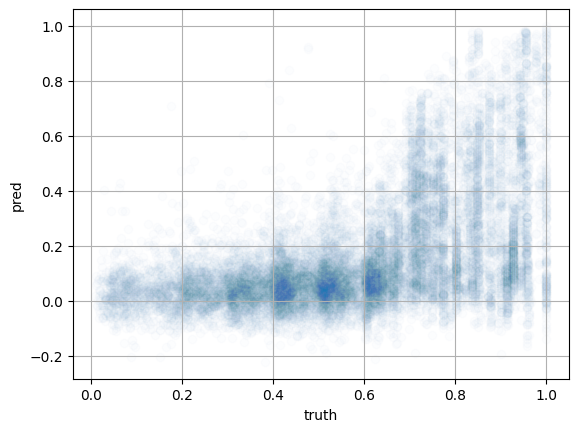

In [164]:
import matplotlib.pyplot as plt
plt.scatter(tanimoto_spec2vec, scores_spec2vec, alpha=0.01)
plt.ylabel('pred')
plt.xlabel('truth')
plt.grid()

In [165]:
tanimoto_spec2vec_binary=[1 if t>THRESHOLD_ANALOG else 0 for t in tanimoto_spec2vec]
scores_spec2vec= [s if s>0 else 0 for s in scores_spec2vec ]

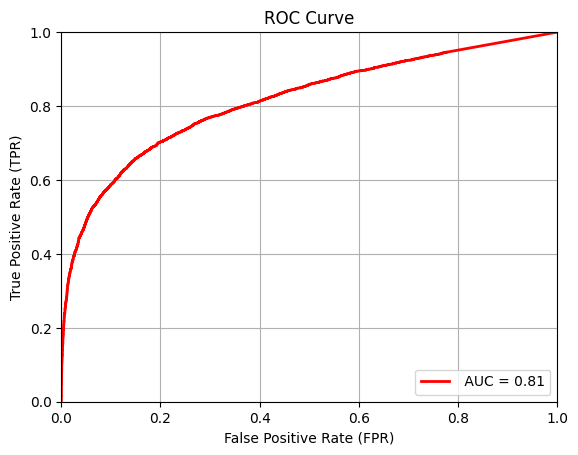

In [166]:
Plotting.plot_roc_curve(tanimoto_spec2vec_binary, 
                        scores_spec2vec)

In [167]:
spearman_spec2vec = spearmanr(tanimoto_spec2vec, scores_spec2vec)

## MS2DEEPSCORE

In [168]:
similarity_ms2 = MS2DeepScoreComparison.get_ms2deepscore_similarity(model_ms2d_file)

In [200]:
random_molecule_pairs_indexes = np.random.choice(range(0,len(molecule_pairs)), size=10000)

In [208]:
random_molecule_pairs_indexes[0]

14372

In [ ]:
import tensorflow as tf
from datetime import datetime
start =datetime.now()
with tf.device('/device:CPU:0'):
    tanimotos_ms2 , scores_ms2 = MS2DeepScoreComparison.compute_ms2deepscore(molecule_pairs, 
                        random_molecule_pairs_indexes, 
                        original_spectrum_match_hash, 
                        target_hashes_subset,
                        similarity_ms2,)
end = datetime.now()

print(f'total seconds {(end-start).total_seconds()}')

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3104.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 13ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 13ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1097.70it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5289.16it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1736.05it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2104.52it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 512.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3498.17it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9597.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3545.48it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 220.50it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3030.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13842.59it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5809.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6502.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 757.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4165.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4369.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4951.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6105.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7133.17it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6364.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4185.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5005.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5315.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6141.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3331.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3919.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 858.43it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4505.16it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10782.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4854.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7345.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5924.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2232.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3938.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8208.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 232.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5714.31it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6636.56it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9279.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12710.01it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1616.30it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5184.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2603.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3106.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25575.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2198.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 934.56it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4832.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7943.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7133.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5017.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5809.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8490.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 403.73it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3533.53it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5785.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9686.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1745.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6403.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7943.76it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4443.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1572.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 741.17it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4236.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14768.68it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4609.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5983.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2644.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4804.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1626.33it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7884.03it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5023.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2380.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2319.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9238.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5322.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5924.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3775.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3236.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19328.59it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14979.66it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1501.18it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6657.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2674.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3813.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1269.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6017.65it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 213.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2007.80it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8594.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3650.40it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5370.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7626.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6223.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26379.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4236.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18315.74it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5322.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2114.06it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4369.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6657.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1828.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2416.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5526.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1223.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5675.65it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2730.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5447.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1926.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4236.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12157.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5974.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4804.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13934.56it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5405.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 798.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5468.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5289.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10782.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8793.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4132.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1708.47it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4739.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5940.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5793.24it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 234.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1285.41it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5102.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5256.02it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6364.65it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3663.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3401.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3194.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6168.09it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5370.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3279.36it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3876.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13617.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3374.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6087.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5722.11it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1626.33it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

1/1 [==============================] - 0s 11ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7626.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3692.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1225.69it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2616.53it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1276.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2618.17it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3569.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14979.66it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3509.88it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3731.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9404.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5370.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2525.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13934.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4169.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 809.87it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2283.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4777.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 888.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2114.06it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10131.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1038.45it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4969.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25420.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6584.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6105.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18315.74it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4568.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1732.47it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8272.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2236.96it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 286.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1240.92it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8422.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7423.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3521.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7943.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1440.85it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1591.77it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9020.01it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 871.09it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5210.32it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4739.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6105.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 442.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2732.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3331.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2933.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3876.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11650.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2155.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3342.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10131.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4559.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6678.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5315.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6335.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7913.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25731.93it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6721.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4739.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8388.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11275.01it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5722.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6403.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4443.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5785.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4563.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13189.64it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4100.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6017.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5714.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4670.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9279.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 204.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2299.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4405.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13189.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6543.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8507.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 282.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1492.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2770.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3204.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14979.66it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13231.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 259.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4116.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4549.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3862.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2898.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13189.64it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7108.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1733.18it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9279.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3844.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6584.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5178.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6297.75it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2087.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1968.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8388.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6364.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4116.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1540.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4341.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1546.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6898.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6423.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2083.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2314.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26886.56it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5584.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 741.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1939.11it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6241.52it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5184.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14563.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1652.60it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 987.13it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2174.34it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2507.06it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5497.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7182.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6017.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6105.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4181.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4809.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5497.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9597.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5841.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2252.58it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4788.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25731.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4132.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13662.23it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5295.84it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9020.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5683.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 183.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2900.63it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5518.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6678.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7476.48it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9868.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2309.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6462.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4324.02it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8665.92it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 11ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6278.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4696.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1028.02it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4466.78it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15196.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12446.01it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 457.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1811.79it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4826.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5706.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5645.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5645.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4837.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6932.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3758.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5706.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5489.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 964.21it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2584.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5289.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 997.93it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5683.34it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1969.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7345.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13842.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3679.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14768.68it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5029.14it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11650.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 199.72it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3006.67it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12865.96it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 246.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1222.47it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3521.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5102.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2212.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5096.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1281.88it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3679.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1960.87it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4032.98it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4462.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3483.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4080.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4899.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3971.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1714.76it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4505.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10782.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5029.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1904.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6898.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 741.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3435.14it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4712.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 729.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4505.16it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18641.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4951.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1626.33it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1086.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11459.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5405.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3331.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 771.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4369.07it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8665.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4529.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13231.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25575.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10131.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3030.57it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 149.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1342.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5356.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3919.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3751.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3663.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7825.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11650.84it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7503.23it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4048.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1703.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4718.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4568.96it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5084.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1245.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5315.97it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1368.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1377.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6543.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2352.39it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1964.55it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2359.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6584.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3964.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5178.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3269.14it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4826.59it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5356.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1855.07it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7397.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2654.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7133.17it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3423.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2816.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5005.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3758.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5497.12it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14979.66it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4809.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1844.46it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1610.10it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5053.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 530.79it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3569.62it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6502.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 448.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3584.88it/s]


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4696.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5053.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24818.37it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1213.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5691.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12018.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1309.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5924.16it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3486.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1057.30it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5184.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12228.29it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12087.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1038.45it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5133.79it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11397.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5592.41it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1388.84it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6721.64it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4877.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1655.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5184.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5023.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2857.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7133.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5518.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5053.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6898.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7913.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2392.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2974.68it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 695.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4048.56it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5159.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2187.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4691.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5526.09it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6105.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 784.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4975.45it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4832.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 230.47it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1407.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6932.73it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2908.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12157.40it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6141.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5102.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2052.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3581.81it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6335.81it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2438.55it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8208.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4505.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8272.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6326.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2924.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 744.07it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6168.09it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7463.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4240.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2066.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9868.95it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3715.06it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8272.79it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 833.36it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6168.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3066.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7503.23it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8388.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4401.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13934.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2531.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 150.60it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1286.60it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1256.53it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3908.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4604.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5165.40it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1808.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12087.33it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5377.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5210.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12228.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3625.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24528.09it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 17ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5809.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5745.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 155.62it/s]

Create BinnedSpectrum instances: 100%|██████████████████████████| 1/1 [00:00<00:00, 716.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4048.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6017.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1124.48it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5152.71it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4310.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

1/1 [==============================] - 0s 13ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9489.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4832.15it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5489.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6186.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4510.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 190.05it/s]

Create BinnedSpectrum instances: 100%|██████████████████████████| 1/1 [00:00<00:00, 978.61it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 632.15it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3983.19it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5745.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5178.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 384.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2513.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5108.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6316.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 17ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4002.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6932.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5809.29it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7397.36it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3968.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 363.24it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3088.59it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11275.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4500.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5874.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7463.17it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2012.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4832.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12228.29it/s]


1/1 [==============================] - 0s 19ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5398.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 16ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1280.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]


1/1 [==============================] - 0s 26ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4165.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]


1/1 [==============================] - 0s 17ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4766.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6462.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4524.60it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7503.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2212.19it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8355.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8594.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11275.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1521.88it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6743.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4563.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2331.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3426.72it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8208.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5269.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3813.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)




1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1110.78it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 29ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5096.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4447.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3530.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12300.01it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3949.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 15ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3569.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3731.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5489.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12157.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 551.30it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3919.91it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5159.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3679.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14873.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6052.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3862.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12945.38it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1122.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7943.76it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1655.21it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1531.33it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3964.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1969.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3953.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6316.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2631.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5924.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5269.23it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4788.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3813.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2118.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5282.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3460.65it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4549.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2062.10it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2100.30it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4999.17it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6594.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4899.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3799.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4614.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 712.23it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2716.52it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7397.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2906.66it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13189.64it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 647.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3106.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4466.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12228.29it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5077.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 944.24it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5645.09it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4583.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4466.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4718.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4766.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5152.71it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4032.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2288.22it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8422.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4346.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5745.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6492.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3569.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13357.66it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 500.75it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4401.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7133.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7738.57it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3336.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10131.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 196.54it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2957.90it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12157.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9642.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3269.14it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 792.87it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2142.14it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 644.29it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3919.91it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 953.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5005.14it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4462.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3775.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15768.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4696.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1825.99it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6403.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4588.95it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6462.72it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24244.53it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 198.46it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2888.64it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6141.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4132.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1798.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1766.77it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1347.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1515.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2425.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10951.19it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5645.09it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6932.73it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4424.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5983.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10782.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4670.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4826.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7256.58it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6898.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1351.26it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2101.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1508.20it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3908.95it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7332.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6364.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14217.98it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3184.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2590.68it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1220.69it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1620.05it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4424.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11650.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7397.36it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5071.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1991.60it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9642.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3634.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12087.33it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5210.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1387.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2723.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1319.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6316.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2206.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4036.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5526.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3675.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11397.57it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4202.71it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1032.06it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4568.96it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6168.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3813.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 17ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2462.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 208.56it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2914.74it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5745.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13842.59it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5691.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4013.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4405.78it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1473.24it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8388.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13357.66it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3569.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4975.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5675.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8355.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5809.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6482.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4310.69it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4524.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3134.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1398.57it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1691.93it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1445.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7231.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2475.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

1/1 [==============================] - 0s 13ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15087.42it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7256.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6502.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24244.53it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2841.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3028.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4236.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5526.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1146.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5907.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15196.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4429.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5005.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5178.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8272.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13357.66it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 247.66it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1636.48it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4064.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4650.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1234.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3806.08it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9020.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3833.92it/s]



1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3721.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4202.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5029.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5133.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2451.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13842.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26214.40it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1919.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11459.85it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13842.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25731.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3650.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12710.01it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 292.65it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1298.95it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2376.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4588.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3390.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12157.40it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4443.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1615.68it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25575.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1474.79it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3731.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1795.51it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6335.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7738.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6204.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1400.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8594.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3557.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4324.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13189.64it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1754.20it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3518.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 970.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2149.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11155.06it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3030.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 125.99it/s]

Create BinnedSpectrum instances: 100%|██████████████████████████| 1/1 [00:00<00:00, 933.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2242.94it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14873.42it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1912.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4804.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3204.20it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2818.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4382.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2957.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7476.48it/s]


1/1 [==============================] - 0s 17ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4452.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3175.10it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6069.90it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3506.94it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5592.41it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19065.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1353.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12710.01it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 794.98it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1942.71it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6326.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1776.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12300.01it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2003.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5295.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1845.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11459.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14027.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3276.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1171.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1562.12it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5592.41it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 236.13it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2807.43it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7206.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2449.94it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9686.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5577.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1264.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5841.65it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7653.84it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1075.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5405.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14217.98it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7626.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18315.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1703.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2943.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 144.53it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1187.85it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 569.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3584.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1410.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6364.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4832.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4922.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 803.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7397.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13934.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26214.40it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4691.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1795.51it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8422.30it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5468.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]


1/1 [==============================] - 0s 18ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5029.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4877.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 169.95it/s]

Create BinnedSpectrum instances: 100%|██████████████████████████| 1/1 [00:00<00:00, 933.73it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 15ms/step




Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1008.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4975.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4809.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3390.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3718.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14768.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7061.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4236.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8793.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5023.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14768.68it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 729.95it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4306.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6502.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5405.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4315.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14217.98it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4583.94it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7626.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18641.35it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11275.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4718.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 447.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2474.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1802.45it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8208.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5475.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12787.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3862.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6462.72it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6657.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1678.39it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6710.89it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1715.46it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2293.22it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1290.56it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4696.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2158.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13934.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24244.53it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18315.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 448.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2880.70it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1369.79it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8507.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3833.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6543.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24966.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2941.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5108.77it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5722.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5737.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5077.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6831.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7281.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7626.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20262.34it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1515.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6887.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1661.11it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4788.02it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1383.35it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5614.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 200.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1218.21it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5203.85it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14074.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23696.63it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1475.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6636.56it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7256.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4718.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8388.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4198.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10618.49it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4614.20it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5282.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1065.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11848.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6017.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5322.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13662.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9686.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6326.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20971.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4975.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1360.90it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1198.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7294.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4500.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13486.51it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13662.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4271.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9078.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13025.79it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26379.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8355.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4854.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7884.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5817.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7157.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25575.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3542.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9118.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6626.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5017.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16070.13it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10106.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5084.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3437.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2308.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10951.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5675.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12483.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 958.70it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4293.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1441.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10180.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6543.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6052.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4739.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4052.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14873.42it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 384.16it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1837.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6326.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3731.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12865.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21845.33it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4529.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3545.48it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6754.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2128.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1492.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3109.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3771.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3609.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3692.17it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3572.66it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5256.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17623.13it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1949.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8665.92it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3472.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2987.40it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1733.18it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7463.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15196.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4809.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 751.94it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4223.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2739.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1041.55it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5518.82it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1218.21it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4544.21it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6743.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1054.91it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5461.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1230.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7884.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1718.98it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5652.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4481.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4804.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15196.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6413.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3192.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2223.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4364.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2799.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3581.81it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12633.45it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5412.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4447.83it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3398.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11715.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14873.42it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9198.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10082.46it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1538.63it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1621.30it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3401.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7423.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8594.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22310.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1842.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 26379.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7423.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4609.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3086.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1046.22it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4911.36it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13357.66it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7928.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10837.99it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5236.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4064.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4443.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6403.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8144.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6668.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 503.28it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3587.94it/s]


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7503.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21183.35it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17331.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4670.72it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1926.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14122.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3039.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10951.19it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8830.11it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11881.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7194.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5940.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5683.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4132.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4848.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5343.06it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4002.20it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4928.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13662.23it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 494.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2704.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7256.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2122.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11397.57it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6052.39it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6087.52it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4219.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3938.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14315.03it/s]

1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10979.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24528.09it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 890.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4568.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2126.93it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5084.00it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 251.82it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2931.03it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4999.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14463.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25575.02it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7516.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 691.10it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5555.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9020.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4877.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12710.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24244.53it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1485.76it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5983.32it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21399.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5949.37it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7281.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2067.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12192.74it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 12ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5683.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7037.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3355.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5857.97it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3248.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11618.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3019.66it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 227.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2551.28it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11522.81it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4275.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2122.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9238.56it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9258.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5349.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7884.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22671.91it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12228.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22919.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9731.56it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6213.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5991.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12985.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 673.46it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3998.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1067.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6944.21it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4215.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4788.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10131.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19878.22it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5412.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4429.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13888.42it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7653.84it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9686.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22919.69it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6452.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1286.99it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6250.83it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1772.74it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7884.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1343.47it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6808.94it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5071.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4485.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4826.59it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7049.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3331.46it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1071.89it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12087.33it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 11ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1721.80it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6543.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2053.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5377.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14266.34it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9799.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13315.25it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7332.70it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13357.66it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11244.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1416.52it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7358.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16980.99it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2481.84it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9822.73it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2122.62it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7281.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4032.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23831.27it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9686.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8559.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5785.25it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8701.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 332.78it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1832.37it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7307.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]


1/1 [==============================] - 0s 16ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3650.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16710.37it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4629.47it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2449.94it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]
IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4563.99it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

1/1 [==============================] - 0s 12ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4315.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15141.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6026.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16131.94it/s]

1/1 [==============================] - 0s 15ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6909.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4604.07it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

1/1 [==============================] - ETA: 0s

1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4284.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4675.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7002.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 905.12it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2618.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10330.80it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11335.96it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1565.04it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20763.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9446.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3423.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12826.62it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 261.23it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2716.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5882.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14665.40it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7989.15it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20262.34it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5849.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17772.47it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1972.86it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]


1/1 [==============================] - 0s 17ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 759.42it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4310.69it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2267.19it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4132.32it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6615.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5184.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4387.35it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11125.47it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7410.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4760.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14926.35it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4253.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16320.25it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11781.75it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1449.31it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7639.90it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6853.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12372.58it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13530.01it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5053.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2644.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9489.38it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19972.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7244.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9510.89it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9776.93it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1869.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10433.59it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5412.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2888.64it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9709.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6374.32it/s]


1/1 [==============================] - 0s 16ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4826.59it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4975.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2375.03it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8683.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15420.24it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11650.84it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1035.12it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4899.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17260.51it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7449.92it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4848.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13025.79it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1891.03it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8774.69it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2158.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1769.00it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5210.32it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5178.15it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7752.87it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5152.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15887.52it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8050.49it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10894.30it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8405.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8081.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16578.28it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2128.01it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8943.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10010.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5957.82it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11214.72it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5675.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2700.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12336.19it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5706.54it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16384.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6177.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5384.22it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3701.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4609.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10951.19it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11491.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2335.36it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9619.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14217.98it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7145.32it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8612.53it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8338.58it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20867.18it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12520.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1096.26it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 2432.89it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19328.59it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9892.23it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18558.87it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23301.69it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4670.72it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7584.64it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12052.60it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9000.65it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10512.04it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22795.13it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5047.30it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12945.38it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8905.10it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 950.44it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5433.04it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10538.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 23172.95it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6797.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19599.55it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8848.74it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 183.65it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1650.00it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6574.14it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 15ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7570.95it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17189.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6061.13it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16578.28it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2061.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6978.88it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8756.38it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7695.97it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7281.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8192.00it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21732.15it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5262.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 13148.29it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 12446.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5077.85it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17549.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1964.55it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 664.08it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 4588.95it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8793.09it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10727.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25420.02it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5915.80it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15650.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10305.42it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8004.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 14513.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25115.59it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3155.98it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 11096.04it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7681.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8256.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6132.02it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16194.22it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9915.61it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6909.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16912.52it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4899.89it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 12671.61it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8065.97it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15827.56it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8473.34it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19508.39it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 13706.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 25731.93it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9532.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9177.91it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 211.67it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 1706.39it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7810.62it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20068.44it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4766.25it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7530.17it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11008.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 911.61it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 6168.09it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7943.76it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18808.54it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6533.18it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18236.10it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6442.86it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17476.27it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5753.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18157.16it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8128.50it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9157.87it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10230.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9425.40it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20460.02it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7281.78it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19239.93it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6765.01it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17924.38it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10866.07it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11748.75it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21620.12it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4755.45it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7096.96it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6990.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]

1/1 [==============================] - 0s 14ms/step


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6955.73it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16644.06it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9098.27it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15592.21it/s]

1/1 [==============================] - 0s 13ms/step


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8867.45it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19691.57it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6069.90it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16448.25it/s]


1/1 [==============================] - 0s 13ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3688.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 9341.43it/s]

Spectrum binning: 100%|█████████████████████████████████████████| 1/1 [00:00<00:00, 724.53it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 3495.25it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8112.77it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8924.05it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9986.44it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19328.59it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 3953.16it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14768.68it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1996.34it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8542.37it/s]


1/1 [==============================] - 0s 13ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7084.97it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 7710.12it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 8630.26it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 21290.88it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6096.37it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 15363.75it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10754.63it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 24385.49it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 1116.10it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 5504.34it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5777.28it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 19152.07it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2866.92it/s]

Create BinnedSpectrum instances: 100%|█████████████████████████| 1/1 [00:00<00:00, 8322.03it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2841.67it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10645.44it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6978.88it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 16578.28it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 2933.08it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14716.86it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 9362.29it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 11366.68it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 22192.08it/s]


1/1 [==============================] - 0s 15ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 6288.31it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 10407.70it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 4419.71it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18477.11it/s]


1/1 [==============================] - 0s 14ms/step


Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5127.51it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 14027.77it/s]

Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 5622.39it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 17848.10it/s]


1/1 [==============================] - 0s 14ms/step



Spectrum binning: 100%|████████████████████████████████████████| 1/1 [00:00<00:00, 7869.24it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 18893.26it/s]

Spectrum binning: 100%|███████████████████████████████████████| 1/1 [00:00<00:00, 10205.12it/s]

Create BinnedSpectrum instances: 100%|████████████████████████| 1/1 [00:00<00:00, 20360.70it/s]


1/1 [==============================] - 0s 12ms/step


Spectrum binning:   0%|                                                  | 0/1 [00:00<?, ?it/s]

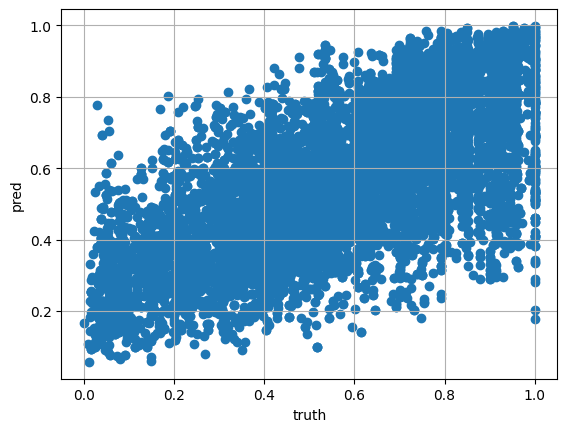

In [209]:
import matplotlib.pyplot as plt
plt.scatter(tanimotos_ms2, [s if s > 0 else 0 for s in scores_ms2], alpha=1)
plt.ylabel('pred')
plt.xlabel('truth')

plt.grid()

In [210]:
tanimotos_ms2_binary= [1 if t>THRESHOLD_ANALOG else 0 for t in tanimotos_ms2]
scores_ms2=[s if s>0 else 0 for s in scores_ms2]

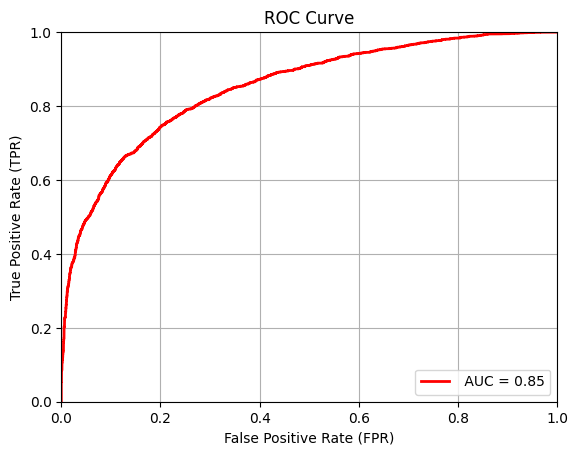

In [211]:

Plotting.plot_roc_curve(tanimotos_ms2_binary, scores_ms2)

In [212]:
spearman_ms2 = spearmanr(tanimotos_ms2, scores_ms2)

## Our model

In [176]:
from src.transformers.sklearn_model import SklearnModel

In [177]:
temp_molecule_pairs= MolecularPairsSet(spectrums= molecule_pairs.spectrums, 
                                      indexes_tani =molecule_pairs.indexes_tani)

In [178]:
#model = Embedder.load_from_checkpoint(
 #           checkpoint_path=transformer_path, d_model=config.D_MODEL, n_layers=config.N_LAYERS
#        )

In [179]:
model =SklearnModel(model_path=transformer_path, d_model=config.D_MODEL, n_layers=config.N_LAYERS)

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


In [180]:
#next(iter(dataloader_test))

In [181]:
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] 

'1'

In [182]:
scores_trans=model.predict_from_molecule_pair(temp_molecule_pairs)

Preprocessing all the data ...


32486it [00:01, 18310.39it/s]


Finished preprocessing 
Starting the loading of the data ...
Normalizing intensities
Creating dictionaries
Preprocessing all the data ...


32486it [00:00, 70263.53it/s]


Finished preprocessing 
Starting the loading of the data ...
Normalizing intensities
Creating dictionaries


/Users/sebas/miniconda3/envs/transformers/lib/python3.11/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'predict_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


Predicting: |                                                            | 0/? [00:00<?, ?it/s]

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
The operator 'aten::_nested_tensor_from_mask_left_aligned' is not currently supported on the MPS backend and will fall back to run on the CPU. This may have performance implications. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/aten/src/ATen/mps/MPSFallback.mm:13.)


Prediction has been called


Predicting: |                                                            | 0/? [00:00<?, ?it/s]

In [183]:
tanimoto_trans = [row[2] for row in molecule_pairs.indexes_tani]

In [184]:
tanimoto_trans_binary=[1 if t>THRESHOLD_ANALOG else 0 for t in tanimoto_trans]
scores_trans=[s if s>0 else 0 for s in (scores_trans)]

In [185]:
spearman_trans = spearmanr(tanimoto_trans, scores_trans)
spearman_trans

SignificanceResult(statistic=0.7472272497456768, pvalue=0.0)

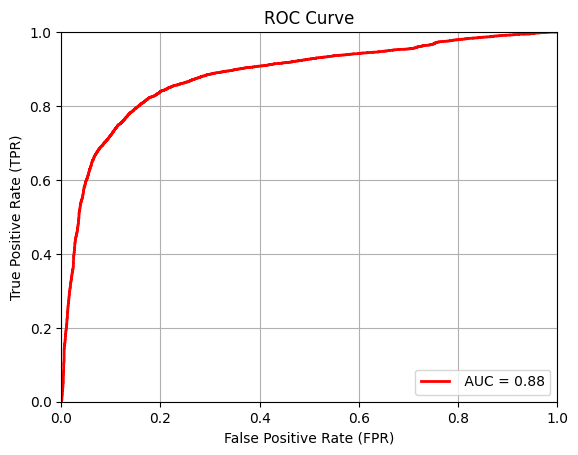

In [186]:
Plotting.plot_roc_curve(tanimoto_trans_binary, scores_trans)

## Plot all results

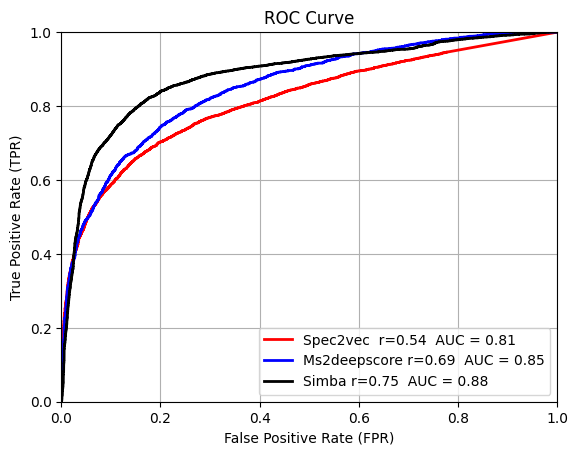

In [213]:
Plotting.plot_n_roc_curves(y_true_list= [tanimoto_spec2vec_binary, tanimotos_ms2_binary, tanimoto_trans_binary],
                           y_scores_list=[scores_spec2vec, scores_ms2, scores_trans],
                           labels=[f'Spec2vec  r={spearman_spec2vec[0]:.2f} ', 
                                   f'Ms2deepscore r={spearman_ms2[0]:.2f} ', 
                                   f'Simba r={spearman_trans[0]:.2f} '],
                           colors = ['r','b','k'])

## Save data

In [188]:
## save spectrums to analyze
#with open('./spectrums_sent.pkl', 'wb') as f:
#    pickle.dump(original_spectrum_match_hash, f)

In [189]:
#pairs = []
#for m in tqdm(molecule_pairs):
#            hash_0 = m.spectrum_object_0.spectrum_hash
#            hash_1 = m.spectrum_object_1.spectrum_hash

#            # get right spectra
#            index_0 = target_hashes_subset.index(hash_0)
#            index_1 = target_hashes_subset.index(hash_1)
#            pairs.append((index_0, index_1))

In [190]:
## save pairs

In [191]:
## save spectrums to analyze
#with open('./pairs_indexes.pkl', 'wb') as f:
#    pickle.dump(pairs, f)